# PREDICTION MODELS OF SYDNEY DAILY PUBLIC TRANSPORT USAGE
## With Specific Application on Predicting End-Of-Year Usage

### **AUTHOR**

An Nhan Nguyen Vu - SID: 530604594

Tien Vinh Dang - SID: 541021641

Chuc An Do - SID: 541023382

# I. Client Bio

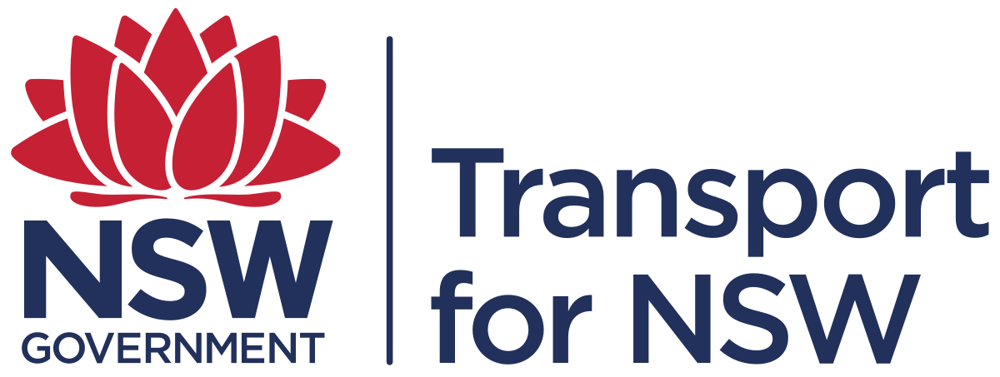

Transport NSW leads the development of safe, integrated and efficient transport systems for the people of NSW. Their services include transport planning, strategy, policy, procurement and other non-service delivery functions across all modes of transport - roads, rail, ferries, light rail, and point to point.

# II. Insights

We have produced two models to predict the number of taps on and taps off at major locations in Greater Sydney. The first model predicts the total number of taps on and taps off per day from now until the end of 2025. The second model predicts the number of taps on and taps off per hour for December 2025. These results help Transport NSW predict public transport usage and make suitable allocations of service, especially during holiday time.

# III. Evidence

In [ ]:
import pandas as pd
from pathlib import Path
from prophet import Prophet
import logging
import cmdstanpy
logging.getLogger('cmdstanpy').setLevel(logging.WARNING)
logging.getLogger('prophet').setLevel(logging.WARNING)
import matplotlib.pyplot as plt

In [2]:
path = "Data"

In [3]:
df = pd.read_csv("Data/OpalPatronage/Opal_Patronage_20200101.txt", delimiter="|")

In [6]:
df["trip_origin_date"] = pd.to_datetime(df["trip_origin_date"], errors="coerce")

In [7]:
df["tap_hour"] = df["tap_hour"].astype(str)

In [8]:
for col in ["Tap_Ons", "Tap_Offs"]:
    df[col] = df[col].replace("<50", "50")      # Replace <50 with "50"
    df[col] = pd.to_numeric(df[col], errors="coerce")  # Convert to int, invalid entries become NaN
    df[col] = df[col].fillna(0).astype(int)     # Optional: Replace NaN with 0, then convert to int

# Datasets used

- Opal patronage, per day for major locations (Jan 2020 - July 2025): Provided by the WDAC organiser.
- Daily total rainfall, maximum temperature, and minimum temperature: Taken from the Bureau of Meteorology’s Weather Station Directory, link: https://reg.bom.gov.au/climate/data/stations/
- Businesses.csv: https://www.abs.gov.au/statistics/economy/business-indicators/counts-australian-businesses-including-entries-and-exits/latest-release#data-downloads
- Population.csv: From our DATA2001 class’s module section (Originally taken from the Australian Bureau of Statistics).
- Connective data used in the process of changing between SA2 regions and postal codes corresponding to regions in the Opal patronage dataset: Taken from the Australian Bureau of Statistics.

# Findings

# 2025 prediction model

Our model is based on the Prophet model, which is a time series model. We use the data from 01/01/2020 to 15/07/2025 as the training dataset, and create a Prophet model based on it to predict the rest of 2025. After that, we visualize the result combined with the given data of the first half of 2025. 

In [11]:
def timeseriesmodelprediction(region: str, option: str = 'total') -> pd.DataFrame:
    DF = pd.DataFrame(columns=['date', 'ons', 'offs', 'total'])
    folder = Path(path + "/OpalPatronage")
    ind = 0
    for file in folder.glob('*.txt'):
        try:
            df = pd.read_csv(file, sep='|')
            df = df[df['ti_region'] == region]
            df[['Tap_Ons', 'Tap_Offs']] = df[['Tap_Ons', 'Tap_Offs']].replace({'<50': 25, '<100': 50})
            df['tap_hour'] = df['tap_hour'].astype(int)
            df['Tap_Ons'] = df['Tap_Ons'].astype(int)
            df['Tap_Offs'] = df['Tap_Offs'].astype(int)
            date = pd.to_datetime(df['trip_origin_date'].unique()[0])
            if date >= pd.to_datetime('2022-01-01'):
                DF.loc[ind] = [date, df['Tap_Ons'].sum(), df['Tap_Offs'].sum(), df['Tap_Ons'].sum() + df['Tap_Offs'].sum()]
                ind += 1
        except Exception:
            pass
    DF.sort_values(by='date', inplace=True)
    DF.dropna(subset=['ons', 'offs', 'total'], inplace=True)
    df_total = DF[['date', option]].copy()
    df_total.rename(columns={'date': 'ds', option: 'y'}, inplace=True)
    df_total['ds'] = pd.to_datetime(df_total['ds'])

    model = Prophet()
    model.fit(df_total)

    future_dates = pd.date_range(start='2025-07-16', periods=169, freq='D')
    future_df = pd.DataFrame({'ds': future_dates})

    forecast = model.predict(future_df)
    return forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].rename(
    columns={
        'ds': 'Date',
        'yhat': 'Predicted value',
        'yhat_lower': 'Lower bound',
        'yhat_upper': 'Upper bound'
    }
)

In [12]:
timeseriesmodelprediction('All - NSW','total')

,Date,Predicted value,Lower bound,Upper bound
0,2025-07-16,4.087584e+06,3.541110e+06,4.628322e+06
1,2025-07-17,4.124749e+06,3.570543e+06,4.606645e+06
2,2025-07-18,3.854401e+06,3.291807e+06,4.357074e+06
3,2025-07-19,2.840190e+06,2.265476e+06,3.354519e+06
4,2025-07-20,2.372334e+06,1.837489e+06,2.966193e+06
...,...,...,...,...
164,2025-12-27,2.269080e+06,1.766813e+06,2.824897e+06
165,2025-12-28,1.756112e+06,1.261408e+06,2.255055e+06
166,2025-12-29,3.096295e+06,2.524087e+06,3.628942e+06
167,2025-12-30,3.463466e+06,2.933315e+06,3.989078e+06


In [13]:
def pre2025(region: str, option: str = 'total'):
    DF = pd.DataFrame(columns=['date', 'ons', 'offs', 'total'])
    folder = Path(path + "/OpalPatronage")
    ind = 0
    for file in folder.glob('*.txt'):
        try:
            df = pd.read_csv(file, sep='|')
            df = df[df['ti_region'] == region]
            df[['Tap_Ons', 'Tap_Offs']] = df[['Tap_Ons', 'Tap_Offs']].replace({'<50': 25, '<100': 50})
            df['tap_hour'] = df['tap_hour'].astype(int)
            df['Tap_Ons'] = df['Tap_Ons'].astype(int)
            df['Tap_Offs'] = df['Tap_Offs'].astype(int)
            date = pd.to_datetime(df['trip_origin_date'].unique()[0])
            if date >= pd.to_datetime('2025-01-01'):
                DF.loc[ind] = [date, df['Tap_Ons'].sum(), df['Tap_Offs'].sum(), df['Tap_Ons'].sum() + df['Tap_Offs'].sum()]
                ind += 1
        except Exception:
            pass
    DF.sort_values(by='date', inplace=True)
    DF.dropna(subset=['ons', 'offs', 'total'], inplace=True)
    df_total = DF[['date', option]].copy()
    return df_total

In [20]:
def timeserieschart(region: str, option: str = 'total'):
    forecast = timeseriesmodelprediction(region, option)
    forecast = forecast.rename(columns={'Date': 'date', 'Predicted value': option})
    forecast = forecast[['date', option]]
    pre2025_df = pre2025(region, option)
    pre2025_df.rename(columns={'date': 'date', option: option}, inplace=True)
    combined_df = pd.concat([pre2025_df, forecast], ignore_index=True)
    plt.figure(figsize=(10, 5))
    plt.plot(combined_df['date'], combined_df[option], color='blue')
    
    latest_data_date = pd.to_datetime('2025-07-15')
    plt.axvline(x=latest_data_date, color='red', linestyle='--', label='Latest data date')
    
    plt.title(f'Timeseries Forecast for {region}')
    plt.xlabel('Date')
    plt.ylabel('Value')
    plt.legend()
    plt.grid()
    plt.show()

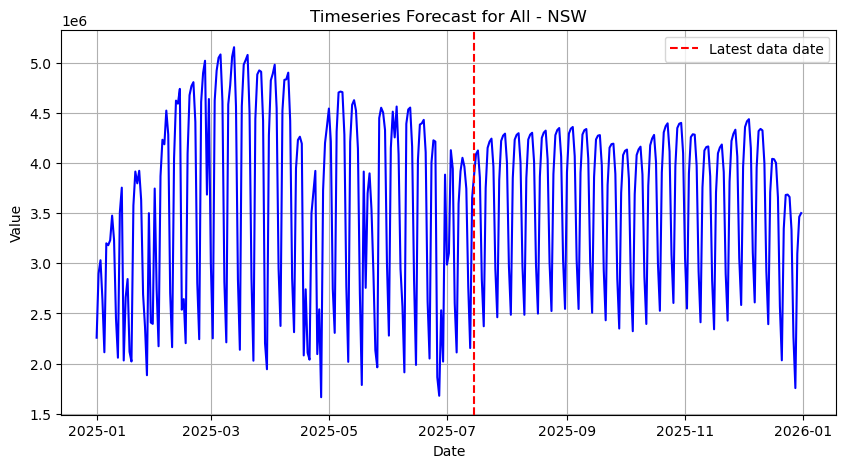

In [21]:
timeserieschart('All - NSW', 'total')

We notice a pattern of dramatic increase and decrease on a weekly basis. This can be explained by our finding that average weekday patronage is more than 50% more than weekend patronage.

In [18]:
track = {}
folder = Path(path + "/OpalPatronage")
for file in folder.glob('*.txt'):
    try:
        df = pd.read_csv(file, sep='|')
        df = df[df['ti_region'] == 'All - NSW']
        df[['Tap_Ons','Tap_Offs']] = df[['Tap_Ons','Tap_Offs']].replace('<50',25)
        df[['Tap_Ons','Tap_Offs']] = df[['Tap_Ons','Tap_Offs']].replace('<100',50)
        df['tap_hour'] = df['tap_hour'].astype(int)
        df['Tap_Ons'] = df['Tap_Ons'].astype(int)
        df['Tap_Offs'] = df['Tap_Offs'].astype(int)
        date = df['trip_origin_date'].unique()[0]
        track[date] = df['Tap_Ons'].sum() + df['Tap_Offs'].sum()
    except Exception:
        pass
        
region_dict = {"Sydney CBD": [2000],
               "Parramatta": [2150],
               "Chatswood": [2067],
               "Macquarie": [2113, 2109],
              "North Sydney": [2060, 2061],
              "Strathfield": [2135],
              "Newcastle and surrounds": [2293, 2300],
              "Wollongong and surrounds": [2500]}

Average weekday patronage: 3069506.79
Average weekend patronage: 1788298.92


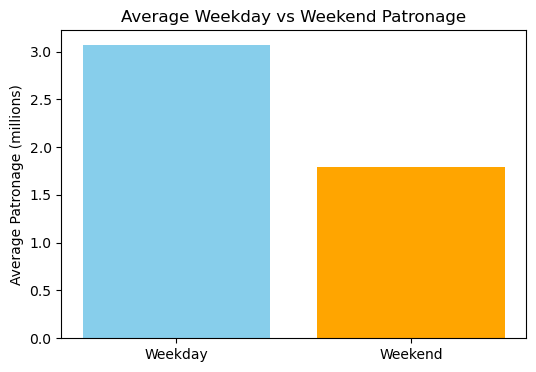

In [19]:
date_range = pd.date_range(start='2020-01-01', end='2025-07-15')
excluded_dates = ['2021-06-03', '2021-06-04']
formatted_dates = [d.strftime('%Y-%m-%d') for d in date_range if d.strftime('%Y-%m-%d') not in excluded_dates]

weekday_total = weekend_total = weekday_count = weekend_count = 0

for date_str in formatted_dates:
    date = pd.to_datetime(date_str)
    count = track.get(date_str, 0)
    if date.weekday() < 5:  # Monday–Friday
        weekday_total += count
        weekday_count += 1
    else:  # Saturday & Sunday
        weekend_total += count
        weekend_count += 1

AVG_WEEKDAY = weekday_total / weekday_count if weekday_count else 0
AVG_WEEKEND = weekend_total / weekend_count if weekend_count else 0

print(f"Average weekday patronage: {AVG_WEEKDAY:.2f}")
print(f"Average weekend patronage: {AVG_WEEKEND:.2f}")

labels = ['Weekday', 'Weekend']
values = [AVG_WEEKDAY / 1e6, AVG_WEEKEND / 1e6]  # Convert to millions

plt.figure(figsize=(6, 4))
plt.bar(labels, values, color=['skyblue', 'orange'])
plt.ylabel('Average Patronage (millions)')
plt.title('Average Weekday vs Weekend Patronage')
plt.show()

# Geospatial time

In [80]:
import pandas as pd

# List of stations to ignore
stations_to_ignore = ["Rosehill", "Camellia", "Rydalmere", "Dundas", "Telopea", "Carlingford"]

# Read in the entries and exits data
ee = pd.read_csv(f"{path}/TrainStationEntriesExits/train-station-entries-exits-data-may-2025.csv")

# Display the first few rows
print(ee.head())

  MonthYear               Station Station_Type  Entry_Exit          Trip
0    Aug-24     Aberdeen  Station         train      Entry  Less than 50
1    Aug-24     Aberdeen  Station         train       Exit  Less than 50
2    Aug-24    Adamstown  Station         train      Entry          2585
3    Aug-24    Adamstown  Station         train       Exit          2391
4    Aug-24  Albion Park  Station         train      Entry          6919


In [82]:
import numpy as np
ee = ee[ee["Station_Type "].isin(["train", "Metro Shared"])]

# Remove " Station" from Station column and trim trailing spaces
ee["Train_Station"] = ee["Station"].str.replace(" Station", "", regex=False)
ee["Train_Station"] = ee["Train_Station"].str.strip()

# Filter out ignored stations
ee = ee[~ee["Train_Station"].isin(stations_to_ignore)]

ee["Trip"] = ee["Trip"].str.strip()  # Clean whitespace

ee["TripNumber"] = pd.to_numeric(ee["Trip"], errors='coerce').fillna(50).astype(int)

In [83]:
# Read in station entrance locations
stations = pd.read_csv(f"{path}/TrainStationEntranceLocations/stationentrances2020_v4.csv")

# Show first few rows
print(stations.head())

  Train_Station Street_Name Street_Type Entrance_Type        LAT        LONG  \
0      Aberdeen    Macqueen          St          Ramp -32.166886  150.891957   
1      Aberdeen    Macqueen          St        Stairs -32.166900  150.891975   
2     Adamstown        Park         Ave          Path -32.933706  151.720452   
3     Adamstown        Park         Ave          Path -32.933827  151.720236   
4     Adamstown    St James          Rd        Stairs -32.933414  151.720363   

   Exit_Number  
0          NaN  
1          NaN  
2          NaN  
3          NaN  
4          NaN  


In [84]:
import pandas as pd
import geopandas as gpd

# Drop duplicate Train_Station entries, keeping the first
stations = stations.drop_duplicates(subset=["Train_Station"])

# Filter stations to include only those present in ee
stations = stations[stations["Train_Station"].isin(ee["Train_Station"])]

In [85]:
stations = stations.set_index("Train_Station")

In [86]:
ee["LAT"] = ee["Train_Station"].map(stations["LAT"])
ee["LONG"] = ee["Train_Station"].map(stations["LONG"])
ee["logTripNumber"] = np.log10(ee["TripNumber"])
print(ee)

     MonthYear               Station Station_Type  Entry_Exit          Trip  \
0       Aug-24     Aberdeen  Station         train      Entry  Less than 50   
1       Aug-24     Aberdeen  Station         train       Exit  Less than 50   
2       Aug-24    Adamstown  Station         train      Entry          2585   
3       Aug-24    Adamstown  Station         train       Exit          2391   
4       Aug-24  Albion Park  Station         train      Entry          6919   
...        ...                   ...           ...        ...           ...   
6277    May-25      Yennora  Station         train       Exit         23100   
6278    May-25   Yerrinbool  Station         train      Entry           360   
6279    May-25   Yerrinbool  Station         train       Exit           273   
6280    May-25      Zig Zag  Station         train      Entry  Less than 50   
6281    May-25      Zig Zag  Station         train       Exit  Less than 50   

     Train_Station  TripNumber        LAT        LO

In [87]:
trains = gpd.read_file(f"{path}/SydneyTrainRoutes/sydneytrains/SydneyTrains.shp")

In [89]:
import plotly.io as pio
pio.renderers.default = "notebook"

In [90]:
import plotly.express as px
import plotly.graph_objects as go
import warnings
warnings.filterwarnings('ignore')


# Reproject train routes to EPSG:4326
trains_ll = trains.to_crs(epsg=4326)

# Create Plotly interactive scatter map
fig = px.scatter_mapbox(
    ee,
    lat="LAT",
    lon="LONG",
    color="logTripNumber",
    hover_name="Train_Station",
    color_continuous_scale="Viridis",
    size_max=10,
    zoom=10,
    mapbox_style="carto-positron"
)

# Add train routes as red lines
for geom in trains_ll.geometry:
    if geom.geom_type == "LineString":
        xs, ys = map(list, geom.xy)
        fig.add_trace(go.Scattermapbox(
            lon=xs,
            lat=ys,
            mode='lines',
            line=dict(color="red", width=2),
            hoverinfo='skip',
            showlegend=False
        ))
    elif geom.geom_type == "MultiLineString":
        for part in geom:
            xs, ys = map(list, part.xy)
            fig.add_trace(go.Scattermapbox(
                lon=xs,
                lat=ys,
                mode='lines',
                line=dict(color="red", width=2),
                hoverinfo='skip',
                showlegend=False
            ))

# Set view limits (similar to coord_sf xlim/ylim)
fig.update_layout(
    mapbox=dict(
        center={"lat": -33.75, "lon": 150.9},
        zoom=8,
    ),
    coloraxis_colorbar=dict(title="log10(TripNumber)"),
    margin={"r":0,"t":0,"l":0,"b":0},
    legend=dict(orientation="h", y=-0.1)
)

fig.show()


In [91]:
sa3 = gpd.read_file(f"{path}/SA3_2021_AUST_SHP_GDA2020/SA3_2021_AUST_GDA2020.shp")
sa3_ll = sa3.to_crs(epsg=4326)

# Filter to Greater Sydney
sydney_sa3 = sa3_ll[sa3_ll['GCC_NAME21'] == 'Greater Sydney']


In [92]:
import json

geojson_sa3 = json.loads(sydney_sa3.to_json())


In [93]:
fig.update_layout(
    mapbox_layers=[
        {
            "source": geojson_sa3,
            "type": "line",
            "color": "black",
            "line": {"width": 1},
            "below": "traces"
        }
    ]
)


In [118]:
import geopandas as gpd
import matplotlib.pyplot as plt

# Load SA2 shapefile
sa2 = gpd.read_file(f"{path}/SA2_2021_AUST_SHP_GDA2020/SA2_2021_AUST_GDA2020.shp")

# Plot
# fig, ax = plt.subplots(figsize=(12, 12))
# sa2.plot(ax=ax, color='lightgrey', edgecolor='black', linewidth=0.3)
# ax.set_title("SA2 Boundaries - Australia", fontsize=15)
# plt.axis('off')
# plt.show()

In [119]:
import plotly.graph_objects as go

# Assume sa2 is already loaded and reprojected to EPSG:4326
sa2_ll = sa2.to_crs(epsg=4326)

# Optional: Filter to Greater Sydney or NSW SA2s if desired
sa2_ll = sa2_ll[sa2_ll['GCC_NAME21'] == 'Greater Sydney']

import json

# Convert SA2 polygons to GeoJSON
geojson_sa2 = json.loads(sa2_ll.to_json())

# Add SA2 outlines as Mapbox layer (no fill, just lines)
fig.update_layout(
    mapbox_layers=[
        {
            "source": geojson_sa2,
            "type": "line",
            "color": "black",
            "line": {"width": 1},
            "below": "traces"
        }
    ]
)

In [121]:
pop_df = pd.read_csv(f'{path}/Population.csv')
pop_df["sa2_code"] = pop_df["sa2_code"].astype("object")
print(pop_df)

      sa2_code                     sa2_name  0-4_people  5-9_people  \
0    102011028     Avoca Beach - Copacabana         424         522   
1    102011029  Box Head - MacMasters Beach         511         666   
2    102011030              Calga - Kulnura         200         225   
3    102011031          Erina - Green Point         683         804   
4    102011032        Gosford - Springfield        1164        1044   
..         ...                          ...         ...         ...   
368  128021537          Royal National Park           2           4   
369  128021538        Sutherland - Kirrawee        1519        1292   
370  128021607                     Engadine        1157        1283   
371  128021608         Loftus - Yarrawarrah         503         487   
372  128021609             Woronora Heights         166         217   

     10-14_people  15-19_people  20-24_people  25-29_people  30-34_people  \
0             623           552           386           222           

In [122]:
sa2_ll["sa2_code"] = sa2_ll["SA2_CODE21"].str.lower()
sa2_ll["sa2_code"] = sa2_ll["sa2_code"].astype(str).str.strip()
pop_df["sa2_code"] = pop_df["sa2_code"].astype(str).str.strip()

In [123]:
sa2_ll_merged = sa2_ll.merge(pop_df, on="sa2_code", how="left")
print(sa2_ll_merged)

    SA2_CODE21                   SA2_NAME21 CHG_FLAG21  CHG_LBL21 SA3_CODE21  \
0    102011028     Avoca Beach - Copacabana          0  No change      10201   
1    102011029  Box Head - MacMasters Beach          0  No change      10201   
2    102011030              Calga - Kulnura          0  No change      10201   
3    102011031          Erina - Green Point          0  No change      10201   
4    102011032        Gosford - Springfield          0  No change      10201   
..         ...                          ...        ...        ...        ...   
368  128021537          Royal National Park          0  No change      12802   
369  128021538        Sutherland - Kirrawee          0  No change      12802   
370  128021607                     Engadine          0  No change      12802   
371  128021608         Loftus - Yarrawarrah          0  No change      12802   
372  128021609             Woronora Heights          0  No change      12802   

                         SA3_NAME21 SA4

# Business

In [124]:
busi_df = pd.read_csv(f'{path}/Businesses.csv')
print(busi_df)

      industry_code                      industry_name   sa2_code  \
0                 A  Agriculture, Forestry and Fishing  101021007   
1                 A  Agriculture, Forestry and Fishing  101021008   
2                 A  Agriculture, Forestry and Fishing  101021009   
3                 A  Agriculture, Forestry and Fishing  101021010   
4                 A  Agriculture, Forestry and Fishing  101021012   
...             ...                                ...        ...   
12212             S                     Other Services  128021538   
12213             S                     Other Services  128021607   
12214             S                     Other Services  128021608   
12215             S                     Other Services  128021609   
12216             S                     Other Services  199999499   

                              sa2_name  0_to_50k_businesses  \
0                            Braidwood                  136   
1                              Karabar       

In [125]:
busi_df["total_size"] = busi_df["0_to_50k_businesses"]*25 
+ busi_df["50k_to_200k_businesses"]*125 
+ busi_df["200k_to_2m_businesses"]*1100 
+ busi_df["2m_to_5m_businesses"]*3500
+ busi_df["5m_to_10m_businesses"]*7500
+ busi_df["10m_or_more_businesses"]*10000

0             0
1             0
2         30000
3             0
4             0
          ...  
12212         0
12213         0
12214         0
12215         0
12216    140000
Name: 10m_or_more_businesses, Length: 12217, dtype: int64

In [126]:
busi_df["sa2_code"] = busi_df["sa2_code"].astype(str).str.strip()

In [328]:
sa2_ll_merged_busi = sa2_ll_merged.merge(busi_df, on="sa2_code", how="left")
print(sa2_ll_merged_busi)

     SA2_CODE21                SA2_NAME21 CHG_FLAG21  CHG_LBL21 SA3_CODE21  \
0     102011028  Avoca Beach - Copacabana          0  No change      10201   
1     102011028  Avoca Beach - Copacabana          0  No change      10201   
2     102011028  Avoca Beach - Copacabana          0  No change      10201   
3     102011028  Avoca Beach - Copacabana          0  No change      10201   
4     102011028  Avoca Beach - Copacabana          0  No change      10201   
...         ...                       ...        ...        ...        ...   
7082  128021609          Woronora Heights          0  No change      12802   
7083  128021609          Woronora Heights          0  No change      12802   
7084  128021609          Woronora Heights          0  No change      12802   
7085  128021609          Woronora Heights          0  No change      12802   
7086  128021609          Woronora Heights          0  No change      12802   

                          SA3_NAME21 SA4_CODE21           SA4_N

In [330]:
total = sa2_ll_merged_busi.groupby("sa2_code")["total_size"].sum().reset_index()
total.rename(columns={"total_size": "total_size"}, inplace=True)
print(total)

      sa2_code  total_size
0    102011028        4525
1    102011029        5825
2    102011030        7325
3    102011031        9975
4    102011032       14025
..         ...         ...
368  128021537           0
369  128021538       12175
370  128021607        5875
371  128021608        2625
372  128021609        1350

[373 rows x 2 columns]


In [334]:
# List of target industries
selected_industries = [
    "Retail Trade",
    "Accommodation and Food Services",
    "Arts and Recreation Services"
]

# Filter the DataFrame
filtered = sa2_ll_merged_busi[sa2_ll_merged_busi["industry_name"].isin(selected_industries)]

# Group by sa2_code and sum employment
retail_hospitality_total = filtered.groupby("sa2_code")["total_size"].sum().reset_index()
retail_hospitality_total.rename(columns={"total_size": "total_hospitality_size"}, inplace=True)
print(retail_hospitality_total)

      sa2_code  total_hospitality_size
0    102011028                     650
1    102011029                     725
2    102011030                     450
3    102011031                    1025
4    102011032                    1900
..         ...                     ...
368  128021537                       0
369  128021538                    1250
370  128021607                     600
371  128021608                     225
372  128021609                      75

[373 rows x 2 columns]


In [336]:
sa2_ll_merged_final = sa2_ll_merged.merge(total, on="sa2_code", how="left")
sa2_ll_merged_final = sa2_ll_merged_final.merge(retail_hospitality_total, on="sa2_code", how="left")

# Merging

In [338]:
sa2_new_to_sa2_old = pd.read_csv(f"{path}/CG_SA2_2016_SA2_2021.csv")

In [341]:
sa2_new_to_sa2_old["SA2_MAINCODE_2016"] = sa2_new_to_sa2_old["SA2_MAINCODE_2016"].round(0).astype("Int64")
sa2_new_to_sa2_old["SA2_MAINCODE_2016"] = sa2_new_to_sa2_old["SA2_MAINCODE_2016"].astype(str).str.strip()

In [343]:
sa2_new_to_sa2_old["SA2_CODE21"] = sa2_new_to_sa2_old["SA2_CODE_2021"]

In [344]:
# Merge using POA_CODE_2021 as the actual SA2 code
sa2_ll_merged_final = sa2_ll_merged_final.merge(
    sa2_new_to_sa2_old,
    on="SA2_CODE21",
    how="left"
)

In [345]:
sa2_ll_merged_final

,SA2_CODE21,SA2_NAME21,CHG_FLAG21,CHG_LBL21,SA3_CODE21,SA3_NAME21,SA4_CODE21,SA4_NAME21,GCC_CODE21,GCC_NAME21,...,total_size,total_hospitality_size,SA2_MAINCODE_2016,SA2_NAME_2016,SA2_CODE_2021,SA2_NAME_2021,RATIO_FROM_TO,INDIV_TO_REGION_QLTY_INDICATOR,OVERALL_QUALITY_INDICATOR,BMOS_NULL_FLAG
0,102011028,Avoca Beach - Copacabana,0,No change,10201,Gosford,102,Central Coast,1GSYD,Greater Sydney,...,4525,650,102011028,Avoca Beach - Copacabana,102011028,Avoca Beach - Copacabana,1.0,Good,Good,0
1,102011029,Box Head - MacMasters Beach,0,No change,10201,Gosford,102,Central Coast,1GSYD,Greater Sydney,...,5825,725,102011029,Box Head - MacMasters Beach,102011029,Box Head - MacMasters Beach,1.0,Good,Good,0
2,102011030,Calga - Kulnura,0,No change,10201,Gosford,102,Central Coast,1GSYD,Greater Sydney,...,7325,450,102011030,Calga - Kulnura,102011030,Calga - Kulnura,1.0,Good,Good,0
3,102011031,Erina - Green Point,0,No change,10201,Gosford,102,Central Coast,1GSYD,Greater Sydney,...,9975,1025,102011031,Erina - Green Point,102011031,Erina - Green Point,1.0,Good,Good,0
4,102011032,Gosford - Springfield,0,No change,10201,Gosford,102,Central Coast,1GSYD,Greater Sydney,...,14025,1900,102011032,Gosford - Springfield,102011032,Gosford - Springfield,1.0,Good,Good,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
377,128021537,Royal National Park,0,No change,12802,Sutherland - Menai - Heathcote,128,Sydney - Sutherland,1GSYD,Greater Sydney,...,0,0,128021537,Royal National Park,128021537,Royal National Park,1.0,Good,Good,0
378,128021538,Sutherland - Kirrawee,0,No change,12802,Sutherland - Menai - Heathcote,128,Sydney - Sutherland,1GSYD,Greater Sydney,...,12175,1250,128021538,Sutherland - Kirrawee,128021538,Sutherland - Kirrawee,1.0,Good,Good,0
379,128021607,Engadine,0,No change,12802,Sutherland - Menai - Heathcote,128,Sydney - Sutherland,1GSYD,Greater Sydney,...,5875,600,128021607,Engadine,128021607,Engadine,1.0,Good,Good,0
380,128021608,Loftus - Yarrawarrah,0,No change,12802,Sutherland - Menai - Heathcote,128,Sydney - Sutherland,1GSYD,Greater Sydney,...,2625,225,128021608,Loftus - Yarrawarrah,128021608,Loftus - Yarrawarrah,1.0,Good,Good,0


In [346]:
sa2_to_poa = pd.read_csv(f"{path}/SA2_to_POA.csv")

In [348]:
# Make sure both are strings and cleaned
sa2_ll_merged_final["sa2_code"] = sa2_ll_merged_final["SA2_MAINCODE_2016"].astype(str).str.strip()
sa2_to_poa["POA_CODE_2021"] = sa2_to_poa["POA_CODE_2021"].astype(str).str.strip()

# Merge using POA_CODE_2021 as the actual SA2 code
merged_with_poa = sa2_ll_merged_final.merge(
    sa2_to_poa[["POA_CODE_2021", "POA_CODE_2016"]],
    left_on="sa2_code",
    right_on="POA_CODE_2021",
    how="left"
)


In [349]:
merged_with_poa

,SA2_CODE21,SA2_NAME21,CHG_FLAG21,CHG_LBL21,SA3_CODE21,SA3_NAME21,SA4_CODE21,SA4_NAME21,GCC_CODE21,GCC_NAME21,...,SA2_MAINCODE_2016,SA2_NAME_2016,SA2_CODE_2021,SA2_NAME_2021,RATIO_FROM_TO,INDIV_TO_REGION_QLTY_INDICATOR,OVERALL_QUALITY_INDICATOR,BMOS_NULL_FLAG,POA_CODE_2021,POA_CODE_2016
0,102011028,Avoca Beach - Copacabana,0,No change,10201,Gosford,102,Central Coast,1GSYD,Greater Sydney,...,102011028,Avoca Beach - Copacabana,102011028,Avoca Beach - Copacabana,1.0,Good,Good,0,102011028,2251.0
1,102011029,Box Head - MacMasters Beach,0,No change,10201,Gosford,102,Central Coast,1GSYD,Greater Sydney,...,102011029,Box Head - MacMasters Beach,102011029,Box Head - MacMasters Beach,1.0,Good,Good,0,102011029,2251.0
2,102011029,Box Head - MacMasters Beach,0,No change,10201,Gosford,102,Central Coast,1GSYD,Greater Sydney,...,102011029,Box Head - MacMasters Beach,102011029,Box Head - MacMasters Beach,1.0,Good,Good,0,102011029,2257.0
3,102011030,Calga - Kulnura,0,No change,10201,Gosford,102,Central Coast,1GSYD,Greater Sydney,...,102011030,Calga - Kulnura,102011030,Calga - Kulnura,1.0,Good,Good,0,102011030,2083.0
4,102011030,Calga - Kulnura,0,No change,10201,Gosford,102,Central Coast,1GSYD,Greater Sydney,...,102011030,Calga - Kulnura,102011030,Calga - Kulnura,1.0,Good,Good,0,102011030,2250.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
886,128021538,Sutherland - Kirrawee,0,No change,12802,Sutherland - Menai - Heathcote,128,Sydney - Sutherland,1GSYD,Greater Sydney,...,128021538,Sutherland - Kirrawee,128021538,Sutherland - Kirrawee,1.0,Good,Good,0,128021538,2227.0
887,128021538,Sutherland - Kirrawee,0,No change,12802,Sutherland - Menai - Heathcote,128,Sydney - Sutherland,1GSYD,Greater Sydney,...,128021538,Sutherland - Kirrawee,128021538,Sutherland - Kirrawee,1.0,Good,Good,0,128021538,2232.0
888,128021607,Engadine,0,No change,12802,Sutherland - Menai - Heathcote,128,Sydney - Sutherland,1GSYD,Greater Sydney,...,128021607,Engadine,128021607,Engadine,1.0,Good,Good,0,NaN,NaN
889,128021608,Loftus - Yarrawarrah,0,No change,12802,Sutherland - Menai - Heathcote,128,Sydney - Sutherland,1GSYD,Greater Sydney,...,128021608,Loftus - Yarrawarrah,128021608,Loftus - Yarrawarrah,1.0,Good,Good,0,NaN,NaN


In [353]:
projected = merged_with_poa[[
    "SA2_CODE21",
    "SA2_NAME21",
    "AREASQKM21",
    "geometry",
    "total_people",
    "total_size",
    "total_hospitality_size",
    "POA_CODE_2016"
]]

In [354]:
projected["POA_CODE_2016"] = projected["POA_CODE_2016"].round(0).astype("Int64")

In [355]:
projected

,SA2_CODE21,SA2_NAME21,AREASQKM21,geometry,total_people,total_size,total_hospitality_size,POA_CODE_2016
0,102011028,Avoca Beach - Copacabana,6.4376,"POLYGON ((151.41373 -33.46558, 151.41362 -33.4...",7530,4525,650,2251
1,102011029,Box Head - MacMasters Beach,32.0802,"POLYGON ((151.37484 -33.50052, 151.37507 -33.5...",11052,5825,725,2251
2,102011029,Box Head - MacMasters Beach,32.0802,"POLYGON ((151.37484 -33.50052, 151.37507 -33.5...",11052,5825,725,2257
3,102011030,Calga - Kulnura,767.9512,"MULTIPOLYGON (((151.20449 -33.5328, 151.20448 ...",4748,7325,450,2083
4,102011030,Calga - Kulnura,767.9512,"MULTIPOLYGON (((151.20449 -33.5328, 151.20448 ...",4748,7325,450,2250
...,...,...,...,...,...,...,...,...
886,128021538,Sutherland - Kirrawee,7.7550,"POLYGON ((151.05006 -34.02158, 151.05008 -34.0...",23369,12175,1250,2227
887,128021538,Sutherland - Kirrawee,7.7550,"POLYGON ((151.05006 -34.02158, 151.05008 -34.0...",23369,12175,1250,2232
888,128021607,Engadine,8.9538,"POLYGON ((150.99568 -34.05361, 150.9957 -34.05...",17379,5875,600,<NA>
889,128021608,Loftus - Yarrawarrah,3.8436,"POLYGON ((151.03955 -34.04175, 151.03954 -34.0...",7354,2625,225,<NA>


In [356]:
poa_old_to_poa_new = pd.read_csv(f"{path}/CG_POA_2016_POA_2021.csv")

In [357]:
poa_old_to_poa_new

,POA_CODE_2016,POA_NAME_2016,POA_CODE_2021,POA_NAME_2021,RATIO_FROM_TO,INDIV_TO_REGION_QLTY_INDICATOR,OVERALL_QUALITY_INDICATOR,BMOS_NULL_FLAG
0,800.0,0800,0800,0800,1.0,Good,Good,0
1,810.0,0810,0810,0810,1.0,Good,Good,0
2,812.0,0812,0812,0812,1.0,Good,Good,0
3,815.0,0815,0810,0810,1.0,Good,Good,0
4,820.0,0820,0820,0820,1.0,Good,Good,0
...,...,...,...,...,...,...,...,...
2882,7470.0,7470,7470,7470,1.0,Good,Good,0
2883,9494.0,No usual address (Aust.),9494,No usual address (Aust.),1.0,Good,Good,0
2884,9797.0,Migratory - Offshore - Shipping (Aust.),9797,Migratory - Offshore - Shipping (Aust.),1.0,Good,Good,0
2885,NaN,NaN,6740,6740,1.0,Good,Good,3


In [358]:
# Ensure both are string type (if needed)
projected["POA_CODE_2016"] = projected["POA_CODE_2016"].astype(str).str.strip()
poa_old_to_poa_new["POA_CODE_2016"] = poa_old_to_poa_new["POA_NAME_2016"].astype(str).str.strip()

# Merge on POA_CODE_2016
merged = projected.merge(
    poa_old_to_poa_new,
    on="POA_CODE_2016",
    how="left"  # or "inner" if you only want matched rows
)

In [359]:
merged

,SA2_CODE21,SA2_NAME21,AREASQKM21,geometry,total_people,total_size,total_hospitality_size,POA_CODE_2016,POA_NAME_2016,POA_CODE_2021,POA_NAME_2021,RATIO_FROM_TO,INDIV_TO_REGION_QLTY_INDICATOR,OVERALL_QUALITY_INDICATOR,BMOS_NULL_FLAG
0,102011028,Avoca Beach - Copacabana,6.4376,"POLYGON ((151.41373 -33.46558, 151.41362 -33.4...",7530,4525,650,2251,2251,2257,2257,3.000000e-07,Good,Good,1.0
1,102011028,Avoca Beach - Copacabana,6.4376,"POLYGON ((151.41373 -33.46558, 151.41362 -33.4...",7530,4525,650,2251,2251,2260,2260,2.160000e-04,Good,Good,1.0
2,102011028,Avoca Beach - Copacabana,6.4376,"POLYGON ((151.41373 -33.46558, 151.41362 -33.4...",7530,4525,650,2251,2251,2251,2251,9.997837e-01,Good,Good,0.0
3,102011029,Box Head - MacMasters Beach,32.0802,"POLYGON ((151.37484 -33.50052, 151.37507 -33.5...",11052,5825,725,2251,2251,2257,2257,3.000000e-07,Good,Good,1.0
4,102011029,Box Head - MacMasters Beach,32.0802,"POLYGON ((151.37484 -33.50052, 151.37507 -33.5...",11052,5825,725,2251,2251,2260,2260,2.160000e-04,Good,Good,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1128,128021538,Sutherland - Kirrawee,7.7550,"POLYGON ((151.05006 -34.02158, 151.05008 -34.0...",23369,12175,1250,2232,2232,2227,2227,2.413900e-03,Good,Good,1.0
1129,128021538,Sutherland - Kirrawee,7.7550,"POLYGON ((151.05006 -34.02158, 151.05008 -34.0...",23369,12175,1250,2232,2232,2232,2232,9.975861e-01,Good,Good,0.0
1130,128021607,Engadine,8.9538,"POLYGON ((150.99568 -34.05361, 150.9957 -34.05...",17379,5875,600,<NA>,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1131,128021608,Loftus - Yarrawarrah,3.8436,"POLYGON ((151.03955 -34.04175, 151.03954 -34.0...",7354,2625,225,<NA>,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [360]:
region_dict = {"Sydney CBD": [2000],
                "North Sydney": [2060, 2061],
               "Chatswood": [2067],
               "Parramatta": [2150],
               "Macquarie": [2113, 2109],
              "Strathfield": [2135],
              "Newcastle and surrounds": [2293, 2300],
              "Wollongong and surrounds": [2500]}

In [361]:
# Flatten region_dict into a postcode-to-region mapping
postcode_to_region = {
    str(postcode): region
    for region, postcodes in region_dict.items()
    for postcode in postcodes
}

In [362]:
merged["region"] = merged["POA_CODE_2021"].astype(str).map(postcode_to_region)

In [363]:
merged

,SA2_CODE21,SA2_NAME21,AREASQKM21,geometry,total_people,total_size,total_hospitality_size,POA_CODE_2016,POA_NAME_2016,POA_CODE_2021,POA_NAME_2021,RATIO_FROM_TO,INDIV_TO_REGION_QLTY_INDICATOR,OVERALL_QUALITY_INDICATOR,BMOS_NULL_FLAG,region
0,102011028,Avoca Beach - Copacabana,6.4376,"POLYGON ((151.41373 -33.46558, 151.41362 -33.4...",7530,4525,650,2251,2251,2257,2257,3.000000e-07,Good,Good,1.0,NaN
1,102011028,Avoca Beach - Copacabana,6.4376,"POLYGON ((151.41373 -33.46558, 151.41362 -33.4...",7530,4525,650,2251,2251,2260,2260,2.160000e-04,Good,Good,1.0,NaN
2,102011028,Avoca Beach - Copacabana,6.4376,"POLYGON ((151.41373 -33.46558, 151.41362 -33.4...",7530,4525,650,2251,2251,2251,2251,9.997837e-01,Good,Good,0.0,NaN
3,102011029,Box Head - MacMasters Beach,32.0802,"POLYGON ((151.37484 -33.50052, 151.37507 -33.5...",11052,5825,725,2251,2251,2257,2257,3.000000e-07,Good,Good,1.0,NaN
4,102011029,Box Head - MacMasters Beach,32.0802,"POLYGON ((151.37484 -33.50052, 151.37507 -33.5...",11052,5825,725,2251,2251,2260,2260,2.160000e-04,Good,Good,1.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1128,128021538,Sutherland - Kirrawee,7.7550,"POLYGON ((151.05006 -34.02158, 151.05008 -34.0...",23369,12175,1250,2232,2232,2227,2227,2.413900e-03,Good,Good,1.0,NaN
1129,128021538,Sutherland - Kirrawee,7.7550,"POLYGON ((151.05006 -34.02158, 151.05008 -34.0...",23369,12175,1250,2232,2232,2232,2232,9.975861e-01,Good,Good,0.0,NaN
1130,128021607,Engadine,8.9538,"POLYGON ((150.99568 -34.05361, 150.9957 -34.05...",17379,5875,600,<NA>,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1131,128021608,Loftus - Yarrawarrah,3.8436,"POLYGON ((151.03955 -34.04175, 151.03954 -34.0...",7354,2625,225,<NA>,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [370]:
merged_with_region = merged[merged["region"].notna()]
merged_with_region

,SA2_CODE21,SA2_NAME21,AREASQKM21,geometry,total_people,total_size,total_hospitality_size,POA_CODE_2016,POA_NAME_2016,POA_CODE_2021,POA_NAME_2021,RATIO_FROM_TO,INDIV_TO_REGION_QLTY_INDICATOR,OVERALL_QUALITY_INDICATOR,BMOS_NULL_FLAG,region
299,117031644,Sydney (North) - Millers Point,3.2122,"MULTIPOLYGON (((151.22538 -33.85525, 151.22525...",8199,267200,17000,2000,2000,2000,2000,1.0,Good,Good,0.0,Sydney CBD
300,117031645,Sydney (South) - Haymarket,1.0810,"POLYGON ((151.19852 -33.87579, 151.19847 -33.8...",20346,51800,6600,2000,2000,2000,2000,1.0,Good,Good,0.0,Sydney CBD
534,120011672,Concord West - North Strathfield,4.0969,"POLYGON ((151.08238 -33.8393, 151.0826 -33.838...",12927,10750,1050,2135,2135,2135,2135,1.0,Good,Good,0.0,Strathfield
538,120011673,Rhodes,1.0060,"POLYGON ((151.08457 -33.8261, 151.08478 -33.82...",11629,14025,1925,2135,2135,2135,2135,1.0,Good,Good,0.0,Strathfield
569,120031396,Homebush,3.8432,"POLYGON ((151.06387 -33.86378, 151.0637 -33.86...",21023,19875,1925,2135,2135,2135,2135,1.0,Good,Good,0.0,Strathfield
580,120031678,Burwood (NSW),1.9050,"POLYGON ((151.09813 -33.87299, 151.09817 -33.8...",16048,21600,2725,2135,2135,2135,2135,1.0,Good,Good,0.0,Strathfield
583,120031679,Croydon,2.5877,"POLYGON ((151.10813 -33.87177, 151.10834 -33.8...",10997,8425,675,2135,2135,2135,2135,1.0,Good,Good,0.0,Strathfield
587,121011399,Chatswood (West) - Lane Cove North,5.5372,"POLYGON ((151.15505 -33.79711, 151.15489 -33.7...",21425,15075,1375,2067,2067,2067,2067,1.0,Good,Good,0.0,Chatswood
592,121011682,Artarmon,1.6583,"POLYGON ((151.17842 -33.80883, 151.17858 -33.8...",9469,6275,625,2067,2067,2067,2067,1.0,Good,Good,0.0,Chatswood
596,121011683,Castle Cove - Northbridge,7.6847,"POLYGON ((151.21145 -33.80199, 151.21134 -33.8...",13468,13875,1575,2067,2067,2067,2067,1.0,Good,Good,0.0,Chatswood


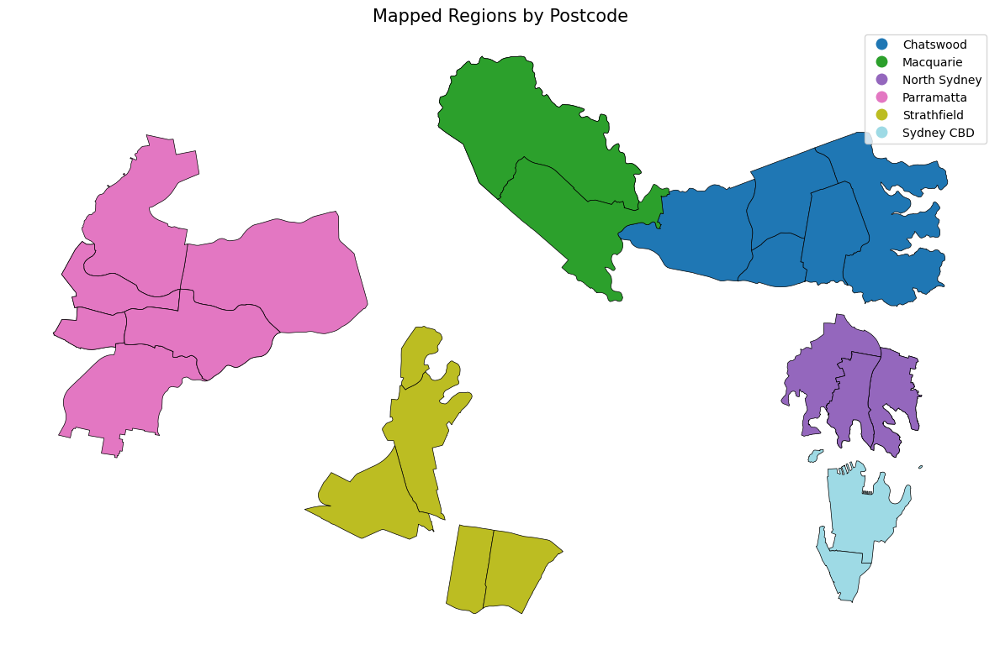

In [371]:
import geopandas as gpd
import matplotlib.pyplot as plt

# Plotting the GeoDataFrame
fig, ax = plt.subplots(figsize=(12, 10))
merged_with_region.plot(
    column="region", 
    cmap="tab20", 
    legend=True, 
    edgecolor="black", 
    linewidth=0.5, 
    ax=ax
)
ax.set_title("Mapped Regions by Postcode", fontsize=15)
ax.axis("off")
plt.tight_layout()
plt.show()

# Cleaning up

In [372]:
merged_with_region

,SA2_CODE21,SA2_NAME21,AREASQKM21,geometry,total_people,total_size,total_hospitality_size,POA_CODE_2016,POA_NAME_2016,POA_CODE_2021,POA_NAME_2021,RATIO_FROM_TO,INDIV_TO_REGION_QLTY_INDICATOR,OVERALL_QUALITY_INDICATOR,BMOS_NULL_FLAG,region
299,117031644,Sydney (North) - Millers Point,3.2122,"MULTIPOLYGON (((151.22538 -33.85525, 151.22525...",8199,267200,17000,2000,2000,2000,2000,1.0,Good,Good,0.0,Sydney CBD
300,117031645,Sydney (South) - Haymarket,1.0810,"POLYGON ((151.19852 -33.87579, 151.19847 -33.8...",20346,51800,6600,2000,2000,2000,2000,1.0,Good,Good,0.0,Sydney CBD
534,120011672,Concord West - North Strathfield,4.0969,"POLYGON ((151.08238 -33.8393, 151.0826 -33.838...",12927,10750,1050,2135,2135,2135,2135,1.0,Good,Good,0.0,Strathfield
538,120011673,Rhodes,1.0060,"POLYGON ((151.08457 -33.8261, 151.08478 -33.82...",11629,14025,1925,2135,2135,2135,2135,1.0,Good,Good,0.0,Strathfield
569,120031396,Homebush,3.8432,"POLYGON ((151.06387 -33.86378, 151.0637 -33.86...",21023,19875,1925,2135,2135,2135,2135,1.0,Good,Good,0.0,Strathfield
580,120031678,Burwood (NSW),1.9050,"POLYGON ((151.09813 -33.87299, 151.09817 -33.8...",16048,21600,2725,2135,2135,2135,2135,1.0,Good,Good,0.0,Strathfield
583,120031679,Croydon,2.5877,"POLYGON ((151.10813 -33.87177, 151.10834 -33.8...",10997,8425,675,2135,2135,2135,2135,1.0,Good,Good,0.0,Strathfield
587,121011399,Chatswood (West) - Lane Cove North,5.5372,"POLYGON ((151.15505 -33.79711, 151.15489 -33.7...",21425,15075,1375,2067,2067,2067,2067,1.0,Good,Good,0.0,Chatswood
592,121011682,Artarmon,1.6583,"POLYGON ((151.17842 -33.80883, 151.17858 -33.8...",9469,6275,625,2067,2067,2067,2067,1.0,Good,Good,0.0,Chatswood
596,121011683,Castle Cove - Northbridge,7.6847,"POLYGON ((151.21145 -33.80199, 151.21134 -33.8...",13468,13875,1575,2067,2067,2067,2067,1.0,Good,Good,0.0,Chatswood


In [373]:
merged_with_region['sa2_code'] = merged_with_region['SA2_CODE21']
merged_with_region['sa2_name'] = merged_with_region['SA2_NAME21']

# FINISHED DATASET

In [374]:
merged_with_region

,SA2_CODE21,SA2_NAME21,AREASQKM21,geometry,total_people,total_size,total_hospitality_size,POA_CODE_2016,POA_NAME_2016,POA_CODE_2021,POA_NAME_2021,RATIO_FROM_TO,INDIV_TO_REGION_QLTY_INDICATOR,OVERALL_QUALITY_INDICATOR,BMOS_NULL_FLAG,region,sa2_code,sa2_name
299,117031644,Sydney (North) - Millers Point,3.2122,"MULTIPOLYGON (((151.22538 -33.85525, 151.22525...",8199,267200,17000,2000,2000,2000,2000,1.0,Good,Good,0.0,Sydney CBD,117031644,Sydney (North) - Millers Point
300,117031645,Sydney (South) - Haymarket,1.0810,"POLYGON ((151.19852 -33.87579, 151.19847 -33.8...",20346,51800,6600,2000,2000,2000,2000,1.0,Good,Good,0.0,Sydney CBD,117031645,Sydney (South) - Haymarket
534,120011672,Concord West - North Strathfield,4.0969,"POLYGON ((151.08238 -33.8393, 151.0826 -33.838...",12927,10750,1050,2135,2135,2135,2135,1.0,Good,Good,0.0,Strathfield,120011672,Concord West - North Strathfield
538,120011673,Rhodes,1.0060,"POLYGON ((151.08457 -33.8261, 151.08478 -33.82...",11629,14025,1925,2135,2135,2135,2135,1.0,Good,Good,0.0,Strathfield,120011673,Rhodes
569,120031396,Homebush,3.8432,"POLYGON ((151.06387 -33.86378, 151.0637 -33.86...",21023,19875,1925,2135,2135,2135,2135,1.0,Good,Good,0.0,Strathfield,120031396,Homebush
580,120031678,Burwood (NSW),1.9050,"POLYGON ((151.09813 -33.87299, 151.09817 -33.8...",16048,21600,2725,2135,2135,2135,2135,1.0,Good,Good,0.0,Strathfield,120031678,Burwood (NSW)
583,120031679,Croydon,2.5877,"POLYGON ((151.10813 -33.87177, 151.10834 -33.8...",10997,8425,675,2135,2135,2135,2135,1.0,Good,Good,0.0,Strathfield,120031679,Croydon
587,121011399,Chatswood (West) - Lane Cove North,5.5372,"POLYGON ((151.15505 -33.79711, 151.15489 -33.7...",21425,15075,1375,2067,2067,2067,2067,1.0,Good,Good,0.0,Chatswood,121011399,Chatswood (West) - Lane Cove North
592,121011682,Artarmon,1.6583,"POLYGON ((151.17842 -33.80883, 151.17858 -33.8...",9469,6275,625,2067,2067,2067,2067,1.0,Good,Good,0.0,Chatswood,121011682,Artarmon
596,121011683,Castle Cove - Northbridge,7.6847,"POLYGON ((151.21145 -33.80199, 151.21134 -33.8...",13468,13875,1575,2067,2067,2067,2067,1.0,Good,Good,0.0,Chatswood,121011683,Castle Cove - Northbridge


# POI

In [380]:
import requests
import time
def boxPOI(box, filters={}):
    baseURL = 'https://maps.six.nsw.gov.au/arcgis/rest/services/public/NSW_POI/MapServer/0/query'
    min_long = box[0] 
    min_lat = box[1] 
    max_long = box[2] 
    max_lat = box[3]
    params = {
        'geometry': f'"xmin":{min_long},"ymin":{min_lat},"xmax":{max_long},"ymax:{max_lat}"',
        'outFields': '*',
        'returnGeometry': 'true',
        'f': 'json'
    }
    response = requests.get(baseURL, params)
    return json.loads(response.text)['features']

In [381]:
all_pois = []

try:
    for index, row in merged_with_region.iterrows():
        x1, y1, x2, y2 = row['geometry'].bounds
        box = [x1, y1, x2, y2]
    
        pois = boxPOI(box)  
        # print(f"{row['sa2_name']}: {len(pois)} POIs")
        for poi in pois:
            poi['sa2_code'] = row['sa2_code']
            poi['sa2_name'] = row['sa2_name']
            all_pois.append(poi)
        time.sleep(1)   
except Exception as e:
    print(f"Error fetching POIS: {e}")

print('Finished!')

Finished!


In [397]:
pois_df = pd.json_normalize(all_pois)

In [398]:
pois_df

,sa2_code,sa2_name,attributes.objectid,attributes.topoid,attributes.poigroup,attributes.poitype,attributes.poiname,attributes.poilabel,attributes.poilabeltype,attributes.poialtlabel,...,attributes.enddate,attributes.lastupdate,attributes.msoid,attributes.centroidid,attributes.shapeuuid,attributes.changetype,attributes.processstate,attributes.urbanity,geometry.x,geometry.y
0,117031644,Sydney (North) - Millers Point,804,500171208,4,Railway Station,CIRCULAR QUAY RAILWAY STATION,CIRCULAR QUAY RAILWAY STATION,NAMED,None,...,32503680000000,1401206226293,166348,None,e334c5ec-97e2-3d31-b9f9-e2062b3c0171,M,None,S,151.210860,-33.861345
1,117031644,Sydney (North) - Millers Point,867,500175774,3,Park,None,Park,GENERIC,None,...,32503680000000,1285588392535,84503,None,872cf9ed-bec5-3c4c-938f-bb1dae3bd6dd,I,None,U,151.219284,-33.872996
2,117031644,Sydney (North) - Millers Point,871,500175809,3,Park,MACQUARIE PLACE,MACQUARIE PLACE,NAMED,None,...,32503680000000,1581500026798,223214,None,7ad67985-ff09-37e6-aef8-356fdc6f9e02,M,None,U,151.210102,-33.863222
3,117031644,Sydney (North) - Millers Point,872,500175842,3,Park,ST NEOT PARK,ST NEOT PARK,NAMED,None,...,32503680000000,1285588392535,87779,None,d17d0fad-1330-37fd-80e0-0574c55e30da,I,None,U,151.225187,-33.867391
4,117031644,Sydney (North) - Millers Point,924,500178007,4,Wharf,None,Wharf,GENERIC,None,...,32503680000000,1368437371444,152815,None,056d2333-324b-3b98-a682-d332e5387ee3,M,None,S,151.225330,-33.854805
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4797,126021501,North Ryde - East Ryde,162401,517014107,2,Primary School,RYDE EAST PUBLIC SCHOOL,RYDE EAST PUBLIC SCHOOL,NAMED,None,...,32503680000000,1741269944355,245034,None,c39a8dfa-1e1c-3f99-b2c7-9cd50b597a8c,M,None,U,151.126648,-33.806798
4798,126021501,North Ryde - East Ryde,163676,517587661,3,Park,CULLEN ST PLAYGROUND,CULLEN ST PLAYGROUND,NAMED,PLAYGROUND,...,32503680000000,1743170299424,245275,None,c5ce978e-07ff-345c-aa82-7a393be0812d,M,None,U,151.151665,-33.814306
4799,126021501,North Ryde - East Ryde,163677,517587669,3,Park,HENLEY PLAYGROUND,HENLEY PLAYGROUND,NAMED,PLAYGROUND,...,32503680000000,1743170299426,245276,None,0d37895a-1fc3-3615-8975-c425fe098307,M,None,U,151.153462,-33.809785
4800,126021501,North Ryde - East Ryde,163678,517587709,3,Park,ALDER AVE PLAYGROUND,ALDER AVE PLAYGROUND,NAMED,PLAYGROUND,...,32503680000000,1743170299428,245277,None,9f47ab52-9c57-3aae-94a9-4deb33fb0861,M,None,U,151.151462,-33.808027


'Park', 'Tourist Attraction', 'Observatory', 'Picnic Area', 'Lookout'

'Tourist Information Centre'

'Shopping Centre'

'Place Of Worship'

# Sites

In [400]:
# Step 1: Define your target POI types
target_types = [
    'Park', 'Tourist Attraction', 'Observatory', 'Picnic Area', 'Lookout'
]

# Step 2: Filter POI dataset to include only target types
filtered_pois = pois_df[pois_df["attributes.poitype"].isin(target_types)]

# Step 3: Count number of POIs per SA2 (assuming each POI has an sa2_code or spatial join already done)
poi_counts = filtered_pois.groupby("sa2_code").size().reset_index(name="site_poi_count")

# Step 4: Merge this count into your SA2 GeoDataFrame
merged_with_region["sa2_code"] = merged_with_region["sa2_code"].astype(str)  # make sure sa2_code is string
poi_counts["sa2_code"] = poi_counts["sa2_code"].astype(str)

merged_with_region = merged_with_region.merge(poi_counts, on="sa2_code", how="left")

# Step 5: Optional: fill NA with 0 (i.e. no POIs of that type in that SA2)
merged_with_region["site_poi_count"] = merged_with_region["site_poi_count"].fillna(0).astype(int)
merged_with_region["site_poi_count"]

0      68
1      13
2      42
3      21
4      31
5      19
6      34
7      51
8      14
9      58
10     28
11     13
12     87
13     94
14     94
15    112
16    112
17     76
18     44
19     48
20     70
21     70
22     24
23     24
24     54
25     54
26    196
27    196
28     92
Name: site_poi_count, dtype: int64

# Info

# site

In [401]:
# Step 1: Define your target POI types
target_types = [
    'Tourist Information Centre'
]

# Step 2: Filter POI dataset to include only target types
filtered_pois = pois_df[pois_df["attributes.poitype"].isin(target_types)]

# Step 3: Count number of POIs per SA2 (assuming each POI has an sa2_code or spatial join already done)
poi_counts = filtered_pois.groupby("sa2_code").size().reset_index(name="tourist_poi_count")

# Step 4: Merge this count into your SA2 GeoDataFrame
merged_with_region["sa2_code"] = merged_with_region["sa2_code"].astype(str)  # make sure sa2_code is string
poi_counts["sa2_code"] = poi_counts["sa2_code"].astype(str)

merged_with_region = merged_with_region.merge(poi_counts, on="sa2_code", how="left")

# Step 5: Optional: fill NA with 0 (i.e. no POIs of that type in that SA2)
merged_with_region["tourist_poi_count"] = merged_with_region["tourist_poi_count"].fillna(0).astype(int)
merged_with_region["tourist_poi_count"]

0     6
1     3
2     0
3     0
4     0
5     0
6     0
7     0
8     0
9     0
10    0
11    0
12    0
13    0
14    0
15    0
16    0
17    0
18    0
19    1
20    2
21    2
22    0
23    0
24    0
25    0
26    0
27    0
28    0
Name: tourist_poi_count, dtype: int64

# Shopping

In [402]:
# Step 1: Define your target POI types
target_types = [
    'Shopping Centre'
]

# Step 2: Filter POI dataset to include only target types
filtered_pois = pois_df[pois_df["attributes.poitype"].isin(target_types)]

# Step 3: Count number of POIs per SA2 (assuming each POI has an sa2_code or spatial join already done)
poi_counts = filtered_pois.groupby("sa2_code").size().reset_index(name="shop_poi_count")

# Step 4: Merge this count into your SA2 GeoDataFrame
merged_with_region["sa2_code"] = merged_with_region["sa2_code"].astype(str)  # make sure sa2_code is string
poi_counts["sa2_code"] = poi_counts["sa2_code"].astype(str)

merged_with_region = merged_with_region.merge(poi_counts, on="sa2_code", how="left")

# Step 5: Optional: fill NA with 0 (i.e. no POIs of that type in that SA2)
merged_with_region["shop_poi_count"] = merged_with_region["shop_poi_count"].fillna(0).astype(int)
merged_with_region["shop_poi_count"]

0     1
1     0
2     1
3     1
4     3
5     2
6     0
7     0
8     0
9     2
10    3
11    1
12    2
13    0
14    0
15    4
16    4
17    0
18    1
19    1
20    4
21    4
22    0
23    0
24    0
25    0
26    6
27    6
28    2
Name: shop_poi_count, dtype: int64

# Churches

In [403]:
# Step 1: Define your target POI types
target_types = [
    'Place Of Worship'
]

# Step 2: Filter POI dataset to include only target types
filtered_pois = pois_df[pois_df["attributes.poitype"].isin(target_types)]

# Step 3: Count number of POIs per SA2 (assuming each POI has an sa2_code or spatial join already done)
poi_counts = filtered_pois.groupby("sa2_code").size().reset_index(name="church_poi_count")

# Step 4: Merge this count into your SA2 GeoDataFrame
merged_with_region["sa2_code"] = merged_with_region["sa2_code"].astype(str)  # make sure sa2_code is string
poi_counts["sa2_code"] = poi_counts["sa2_code"].astype(str)

merged_with_region = merged_with_region.merge(poi_counts, on="sa2_code", how="left")

# Step 5: Optional: fill NA with 0 (i.e. no POIs of that type in that SA2)
merged_with_region["church_poi_count"] = merged_with_region["church_poi_count"].fillna(0).astype(int)
merged_with_region["church_poi_count"]

0     16
1     15
2     12
3      1
4     16
5     10
6      9
7      5
8      3
9     11
10    19
11     7
12    19
13    14
14    14
15    18
16    18
17    10
18    16
19    13
20    20
21    20
22     4
23     4
24    26
25    26
26    32
27    32
28    11
Name: church_poi_count, dtype: int64

In [408]:
final_geospatial_dataset = merged_with_region[[
    "AREASQKM21",
    "SA2_CODE21",
    "geometry",
    "total_people",
    "total_size",
    "total_hospitality_size",
    "region",
    "site_poi_count",
    "tourist_poi_count",
    "shop_poi_count",
    "church_poi_count"
]]

In [409]:
final_geospatial_dataset

,AREASQKM21,SA2_CODE21,geometry,total_people,total_size,total_hospitality_size,region,site_poi_count,tourist_poi_count,shop_poi_count,church_poi_count
0,3.2122,117031644,"MULTIPOLYGON (((151.22538 -33.85525, 151.22525...",8199,267200,17000,Sydney CBD,68,6,1,16
1,1.0810,117031645,"POLYGON ((151.19852 -33.87579, 151.19847 -33.8...",20346,51800,6600,Sydney CBD,13,3,0,15
2,4.0969,120011672,"POLYGON ((151.08238 -33.8393, 151.0826 -33.838...",12927,10750,1050,Strathfield,42,0,1,12
3,1.0060,120011673,"POLYGON ((151.08457 -33.8261, 151.08478 -33.82...",11629,14025,1925,Strathfield,21,0,1,1
4,3.8432,120031396,"POLYGON ((151.06387 -33.86378, 151.0637 -33.86...",21023,19875,1925,Strathfield,31,0,3,16
5,1.9050,120031678,"POLYGON ((151.09813 -33.87299, 151.09817 -33.8...",16048,21600,2725,Strathfield,19,0,2,10
6,2.5877,120031679,"POLYGON ((151.10813 -33.87177, 151.10834 -33.8...",10997,8425,675,Strathfield,34,0,0,9
7,5.5372,121011399,"POLYGON ((151.15505 -33.79711, 151.15489 -33.7...",21425,15075,1375,Chatswood,51,0,0,5
8,1.6583,121011682,"POLYGON ((151.17842 -33.80883, 151.17858 -33.8...",9469,6275,625,Chatswood,14,0,0,3
9,7.6847,121011683,"POLYGON ((151.21145 -33.80199, 151.21134 -33.8...",13468,13875,1575,Chatswood,58,0,2,11


In [414]:
region_aggregated = final_geospatial_dataset.dissolve(
    by="region", 
    aggfunc="sum", 
    as_index=False
)

In [415]:
region_aggregated

,region,geometry,AREASQKM21,total_people,total_size,total_hospitality_size,site_poi_count,tourist_poi_count,shop_poi_count,church_poi_count
0,Chatswood,"POLYGON ((151.20551 -33.81343, 151.20537 -33.8...",21.3566,77156,85250,8550,164,0,6,45
1,Macquarie,"POLYGON ((151.14857 -33.79437, 151.14868 -33.7...",27.5667,63740,51625,6000,484,0,14,75
2,North Sydney,"POLYGON ((151.21563 -33.82776, 151.21603 -33.8...",11.2184,77874,144600,12550,499,0,10,83
3,Parramatta,"POLYGON ((150.99167 -33.83741, 150.99178 -33.8...",39.5275,133878,159600,14175,464,5,10,139
4,Strathfield,"MULTIPOLYGON (((151.11019 -33.8695, 151.11087 ...",13.4388,72624,74675,8300,147,0,7,48
5,Sydney CBD,"MULTIPOLYGON (((151.19804 -33.87477, 151.19794...",4.2932,28545,319000,23600,81,9,1,31


In [416]:
region_aggregated.to_csv("region_summary.csv", index=False)

In [418]:
import pandas as pd
from datetime import datetime, timedelta

# Store data here
all_opal_data = []

# Loop over x = 2, 3, 4 for years 2022, 2023, 2024
for x in [2, 3, 4]:
    start_date = datetime(2000 + 20 + x, 12, 1)
    end_date = datetime(2000 + 20 + x + 1, 1, 1)

    # Loop from Dec 1 to Jan 1 (exclusive)
    current_date = start_date
    while current_date < end_date:
        date_str = current_date.strftime("%Y%m%d")
        file_name = f"{path}/OpalPatronage/Opal_Patronage_{date_str}.txt"
        try:
            df = pd.read_csv(file_name, delimiter="|")
            df["file_date"] = current_date  # Optional: track which file it came from
            all_opal_data.append(df)
        except FileNotFoundError:
            print(f"File not found: {file_name}")
        current_date += timedelta(days=1)

# Concatenate all dataframes
combined_opal_data = pd.concat(all_opal_data, ignore_index=True)

In [420]:
combined_opal_data

,trip_origin_date,mode_name,ti_region,tap_hour,Tap_Ons,Tap_Offs,file_date
0,2022-12-01,Bus,Chatswood,0,<50,<50,2022-12-01
1,2022-12-01,Bus,Macquarie Park,0,<50,<50,2022-12-01
2,2022-12-01,Bus,Newcastle and surrounds,0,<50,<50,2022-12-01
3,2022-12-01,Bus,North Sydney,0,<50,<50,2022-12-01
4,2022-12-01,Bus,Other,0,1000,1500,2022-12-01
...,...,...,...,...,...,...,...
64062,2024-12-31,Train,Parramatta,23,500,800,2024-12-31
64063,2024-12-31,Train,Strathfield,23,200,500,2024-12-31
64064,2024-12-31,Train,Sydney CBD,23,7100,9200,2024-12-31
64065,2024-12-31,Train,Wollongong and surrounds,23,<100,100,2024-12-31


In [421]:
# Replace "<50" with 50, then convert to numeric
for col in ["Tap_Ons", "Tap_Offs"]:
    combined_opal_data[col] = combined_opal_data[col].replace("<50", 50)
    combined_opal_data[col] = pd.to_numeric(combined_opal_data[col], errors="coerce")

In [422]:
combined_opal_data

,trip_origin_date,mode_name,ti_region,tap_hour,Tap_Ons,Tap_Offs,file_date
0,2022-12-01,Bus,Chatswood,0,50.0,50.0,2022-12-01
1,2022-12-01,Bus,Macquarie Park,0,50.0,50.0,2022-12-01
2,2022-12-01,Bus,Newcastle and surrounds,0,50.0,50.0,2022-12-01
3,2022-12-01,Bus,North Sydney,0,50.0,50.0,2022-12-01
4,2022-12-01,Bus,Other,0,1000.0,1500.0,2022-12-01
...,...,...,...,...,...,...,...
64062,2024-12-31,Train,Parramatta,23,500.0,800.0,2024-12-31
64063,2024-12-31,Train,Strathfield,23,200.0,500.0,2024-12-31
64064,2024-12-31,Train,Sydney CBD,23,7100.0,9200.0,2024-12-31
64065,2024-12-31,Train,Wollongong and surrounds,23,NaN,100.0,2024-12-31


In [426]:
aggregated_opal = combined_opal_data.groupby(
    ["ti_region", "trip_origin_date", "tap_hour"], dropna=False
)[["Tap_Ons", "Tap_Offs"]].sum().reset_index()

In [427]:
aggregated_opal

,ti_region,trip_origin_date,tap_hour,Tap_Ons,Tap_Offs
0,All - NSW,2022-12-01,0,3400.0,5700.0
1,All - NSW,2022-12-01,1,1200.0,1600.0
2,All - NSW,2022-12-01,2,800.0,750.0
3,All - NSW,2022-12-01,3,1200.0,600.0
4,All - NSW,2022-12-01,4,9250.0,2750.0
...,...,...,...,...,...
22293,Wollongong and surrounds,2024-12-31,19,600.0,700.0
22294,Wollongong and surrounds,2024-12-31,20,500.0,600.0
22295,Wollongong and surrounds,2024-12-31,21,1000.0,900.0
22296,Wollongong and surrounds,2024-12-31,22,900.0,800.0


In [428]:
# Ensure both columns are string and stripped
aggregated_opal["ti_region"] = aggregated_opal["ti_region"].astype(str).str.strip()
region_aggregated["region"] = region_aggregated["region"].astype(str).str.strip()

# Perform the merge
opal_with_region_data = aggregated_opal.merge(
    region_aggregated,
    left_on="ti_region",
    right_on="region",
    how="left"
)

In [432]:
opal_with_region_data

,ti_region,trip_origin_date,tap_hour,Tap_Ons,Tap_Offs,region,geometry,AREASQKM21,total_people,total_size,total_hospitality_size,site_poi_count,tourist_poi_count,shop_poi_count,church_poi_count
0,All - NSW,2022-12-01,0,3400.0,5700.0,NaN,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,All - NSW,2022-12-01,1,1200.0,1600.0,NaN,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,All - NSW,2022-12-01,2,800.0,750.0,NaN,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,All - NSW,2022-12-01,3,1200.0,600.0,NaN,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,All - NSW,2022-12-01,4,9250.0,2750.0,NaN,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22293,Wollongong and surrounds,2024-12-31,19,600.0,700.0,NaN,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
22294,Wollongong and surrounds,2024-12-31,20,500.0,600.0,NaN,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
22295,Wollongong and surrounds,2024-12-31,21,1000.0,900.0,NaN,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
22296,Wollongong and surrounds,2024-12-31,22,900.0,800.0,NaN,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [433]:
opal_with_region_data = opal_with_region_data.dropna(subset=["church_poi_count"])

In [434]:
opal_with_region_data

,ti_region,trip_origin_date,tap_hour,Tap_Ons,Tap_Offs,region,geometry,AREASQKM21,total_people,total_size,total_hospitality_size,site_poi_count,tourist_poi_count,shop_poi_count,church_poi_count
2232,Chatswood,2022-12-01,0,100.0,150.0,Chatswood,"POLYGON ((151.20551 -33.81343, 151.20537 -33.8...",21.3566,77156.0,85250.0,8550.0,164.0,0.0,6.0,45.0
2233,Chatswood,2022-12-01,1,100.0,100.0,Chatswood,"POLYGON ((151.20551 -33.81343, 151.20537 -33.8...",21.3566,77156.0,85250.0,8550.0,164.0,0.0,6.0,45.0
2234,Chatswood,2022-12-01,2,50.0,50.0,Chatswood,"POLYGON ((151.20551 -33.81343, 151.20537 -33.8...",21.3566,77156.0,85250.0,8550.0,164.0,0.0,6.0,45.0
2235,Chatswood,2022-12-01,3,50.0,50.0,Chatswood,"POLYGON ((151.20551 -33.81343, 151.20537 -33.8...",21.3566,77156.0,85250.0,8550.0,164.0,0.0,6.0,45.0
2236,Chatswood,2022-12-01,4,100.0,100.0,Chatswood,"POLYGON ((151.20551 -33.81343, 151.20537 -33.8...",21.3566,77156.0,85250.0,8550.0,164.0,0.0,6.0,45.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20067,Sydney CBD,2024-12-31,19,13400.0,20900.0,Sydney CBD,"MULTIPOLYGON (((151.19804 -33.87477, 151.19794...",4.2932,28545.0,319000.0,23600.0,81.0,9.0,1.0,31.0
20068,Sydney CBD,2024-12-31,20,10000.0,17200.0,Sydney CBD,"MULTIPOLYGON (((151.19804 -33.87477, 151.19794...",4.2932,28545.0,319000.0,23600.0,81.0,9.0,1.0,31.0
20069,Sydney CBD,2024-12-31,21,24600.0,13800.0,Sydney CBD,"MULTIPOLYGON (((151.19804 -33.87477, 151.19794...",4.2932,28545.0,319000.0,23600.0,81.0,9.0,1.0,31.0
20070,Sydney CBD,2024-12-31,22,18600.0,18900.0,Sydney CBD,"MULTIPOLYGON (((151.19804 -33.87477, 151.19794...",4.2932,28545.0,319000.0,23600.0,81.0,9.0,1.0,31.0


In [3]:
import os

In [10]:
import pandas as pd
from pathlib import Path

# Define folder paths
raw_folder = Path(path) / "WeatherDataProcessing"
clean_folder = Path(path) / "WeatherAtRegions"

# Load CSVs
rainfall_066214 = pd.read_csv(raw_folder / "Rainfall_066214/IDCJAC0009_066214_1800_Data.csv")
rainfall_066006 = pd.read_csv(raw_folder / "Rainfall_066006/IDCJAC0009_066006_1800_Data.csv")
rainfall_066013 = pd.read_csv(raw_folder / "Rainfall_066013/IDCJAC0009_066013_1800_Data.csv")
rainfall_066124 = pd.read_csv(raw_folder / "Rainfall_066124/IDCJAC0009_066124_1800_Data.csv")
rainfall_066213 = pd.read_csv(raw_folder / "Rainfall_066213/IDCJAC0009_066213_1800_Data.csv")

maxTemp_066214 = pd.read_csv(raw_folder / "MaxTemp_066214/IDCJAC0010_066214_1800_Data.csv")
minTemp_066214 = pd.read_csv(raw_folder / "MinTemp_066214/IDCJAC0011_066214_1800_Data.csv")

maxTemp_066124 = pd.read_csv(raw_folder / "MaxTemp_066124/IDCJAC0010_066124_1800_Data.csv")
minTemp_066124 = pd.read_csv(raw_folder / "MinTemp_066124/IDCJAC0011_066124_1800_Data.csv")

maxTemp_066212 = pd.read_csv(raw_folder / "MaxTemp_066212/IDCJAC0010_066212_1800_Data.csv")
minTemp_066212 = pd.read_csv(raw_folder / "MinTemp_066212/IDCJAC0011_066212_1800_Data.csv")

In [16]:
def clean_rainfall(df):
    df = df.rename(columns={'Rainfall amount (millimetres)': 'Rainfall'})
    return df[(df['Year'] >= 2022) & ((df['Month'] == 12) | ((df['Month'] == 1) & (df['Day'] == 1)))]

rainfall_066214 = clean_rainfall(rainfall_066214)
rainfall_066006 = clean_rainfall(rainfall_066006)
rainfall_066013 = clean_rainfall(rainfall_066013)
rainfall_066124 = clean_rainfall(rainfall_066124)
rainfall_066213 = clean_rainfall(rainfall_066213)

In [17]:
def clean_max_temp(df):
    df = df.rename(columns={'Maximum temperature (Degree C)': 'MaxTemp'})
    return df[(df['Year'] >= 2022) & ((df['Month'] == 12) | ((df['Month'] == 1) & (df['Day'] == 1)))]

maxTemp_066214 = clean_max_temp(maxTemp_066214)
maxTemp_066124 = clean_max_temp(maxTemp_066124)
maxTemp_066212 = clean_max_temp(maxTemp_066212)


In [18]:
def clean_min_temp(df):
    df = df.rename(columns={'Minimum temperature (Degree C)': 'MinTemp'})
    df['MinTemp'] = df['MinTemp'].shift(-1).fillna(0)
    df = df[:-1]  # remove the last row
    return df[(df['Year'] >= 2022) & ((df['Month'] == 12) | ((df['Month'] == 1) & (df['Day'] == 1)))]

minTemp_066214 = clean_min_temp(minTemp_066214)
minTemp_066124 = clean_min_temp(minTemp_066124)
minTemp_066212 = clean_min_temp(minTemp_066212)

In [19]:
def make_region_df(region, rainfall_df, max_temp_df, min_temp_df):
    date = pd.to_datetime(dict(year=rainfall_df['Year'], month=rainfall_df['Month'], day=rainfall_df['Day']))
    return pd.DataFrame({
        'Region': region,
        'Date': date,
        'Rainfall': rainfall_df['Rainfall'].values,
        'MaxTemp': max_temp_df['MaxTemp'].values,
        'MinTemp': min_temp_df['MinTemp'].values
    })

NorthSydney = make_region_df("North Sydney", rainfall_066214, maxTemp_066214, minTemp_066214)
Chatswood = make_region_df("Chatswood", rainfall_066213, maxTemp_066214, minTemp_066214)
MacquariePark = make_region_df("Macquarie Park", rainfall_066213, maxTemp_066212, minTemp_066212)
SydneyCBD = make_region_df("Sydney CBD", rainfall_066214, maxTemp_066214, minTemp_066214)
Parramatta = make_region_df("Parramatta", rainfall_066124, maxTemp_066124, minTemp_066124)
Strathfield = make_region_df("Strathfield", rainfall_066013, maxTemp_066212, minTemp_066212)

In [20]:
NorthSydney.to_csv(clean_folder / "NorthSydney.csv", index=False)
Chatswood.to_csv(clean_folder / "Chatswood.csv", index=False)
MacquariePark.to_csv(clean_folder / "Macqu+ariePark.csv", index=False)
SydneyCBD.to_csv(clean_folder / "SydneyCBD.csv", index=False)
Parramatta.to_csv(clean_folder / "Parramatta.csv", index=False)
Strathfield.to_csv(clean_folder / "Strathfield.csv", index=False)

In [437]:
files = [f for f in os.listdir(f"{path}/WeatherAtRegions") if f.endswith(".csv")]

# Read and combine, adding region info
weather_dfs = []
for file in files:
    region_name = os.path.splitext(file)[0]  # e.g., "Chatswood"
    df = pd.read_csv(os.path.join(f"{path}/WeatherAtRegions", file))
    df["region"] = region_name  # Add region as a new column
    weather_dfs.append(df)

# Concatenate all
combined_weather_df = pd.concat(weather_dfs, ignore_index=True)

In [438]:
combined_weather_df

,Region,Date,Rainfall,MaxTemp,MinTemp,region
0,Strathfield,2022-12-01,0.0,21.6,14.4,Strathfield
1,Strathfield,2022-12-02,0.0,23.2,13.2,Strathfield
2,Strathfield,2022-12-03,0.0,24.2,13.8,Strathfield
3,Strathfield,2022-12-04,0.0,26.7,14.6,Strathfield
4,Strathfield,2022-12-05,0.0,32.3,16.4,Strathfield
...,...,...,...,...,...,...
571,Sydney CBD,2024-12-28,0.4,27.2,19.6,SydneyCBD
572,Sydney CBD,2024-12-29,0.0,30.2,20.3,SydneyCBD
573,Sydney CBD,2024-12-30,0.0,28.2,21.1,SydneyCBD
574,Sydney CBD,2024-12-31,0.0,30.1,20.9,SydneyCBD


In [439]:
# Ensure columns are in the same format
combined_weather_df["Region"] = combined_weather_df["Region"].astype(str).str.strip()
combined_weather_df["Date"] = pd.to_datetime(combined_weather_df["Date"])

opal_with_region_data["ti_region"] = opal_with_region_data["ti_region"].astype(str).str.strip()
opal_with_region_data["trip_origin_date"] = pd.to_datetime(opal_with_region_data["trip_origin_date"])

# Perform the merge on both keys
merged_weather_opal = opal_with_region_data.merge(
    combined_weather_df,
    left_on=["ti_region", "trip_origin_date"],
    right_on=["Region", "Date"],
    how="left"
)


In [440]:
merged_weather_opal

,ti_region,trip_origin_date,tap_hour,Tap_Ons,Tap_Offs,region_x,geometry,AREASQKM21,total_people,total_size,...,site_poi_count,tourist_poi_count,shop_poi_count,church_poi_count,Region,Date,Rainfall,MaxTemp,MinTemp,region_y
0,Chatswood,2022-12-01,0,100.0,150.0,Chatswood,"POLYGON ((151.20551 -33.81343, 151.20537 -33.8...",21.3566,77156.0,85250.0,...,164.0,0.0,6.0,45.0,Chatswood,2022-12-01,0.0,22.5,15.2,Chatswood
1,Chatswood,2022-12-01,1,100.0,100.0,Chatswood,"POLYGON ((151.20551 -33.81343, 151.20537 -33.8...",21.3566,77156.0,85250.0,...,164.0,0.0,6.0,45.0,Chatswood,2022-12-01,0.0,22.5,15.2,Chatswood
2,Chatswood,2022-12-01,2,50.0,50.0,Chatswood,"POLYGON ((151.20551 -33.81343, 151.20537 -33.8...",21.3566,77156.0,85250.0,...,164.0,0.0,6.0,45.0,Chatswood,2022-12-01,0.0,22.5,15.2,Chatswood
3,Chatswood,2022-12-01,3,50.0,50.0,Chatswood,"POLYGON ((151.20551 -33.81343, 151.20537 -33.8...",21.3566,77156.0,85250.0,...,164.0,0.0,6.0,45.0,Chatswood,2022-12-01,0.0,22.5,15.2,Chatswood
4,Chatswood,2022-12-01,4,100.0,100.0,Chatswood,"POLYGON ((151.20551 -33.81343, 151.20537 -33.8...",21.3566,77156.0,85250.0,...,164.0,0.0,6.0,45.0,Chatswood,2022-12-01,0.0,22.5,15.2,Chatswood
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11153,Sydney CBD,2024-12-31,19,13400.0,20900.0,Sydney CBD,"MULTIPOLYGON (((151.19804 -33.87477, 151.19794...",4.2932,28545.0,319000.0,...,81.0,9.0,1.0,31.0,Sydney CBD,2024-12-31,0.0,30.1,20.9,SydneyCBD
11154,Sydney CBD,2024-12-31,20,10000.0,17200.0,Sydney CBD,"MULTIPOLYGON (((151.19804 -33.87477, 151.19794...",4.2932,28545.0,319000.0,...,81.0,9.0,1.0,31.0,Sydney CBD,2024-12-31,0.0,30.1,20.9,SydneyCBD
11155,Sydney CBD,2024-12-31,21,24600.0,13800.0,Sydney CBD,"MULTIPOLYGON (((151.19804 -33.87477, 151.19794...",4.2932,28545.0,319000.0,...,81.0,9.0,1.0,31.0,Sydney CBD,2024-12-31,0.0,30.1,20.9,SydneyCBD
11156,Sydney CBD,2024-12-31,22,18600.0,18900.0,Sydney CBD,"MULTIPOLYGON (((151.19804 -33.87477, 151.19794...",4.2932,28545.0,319000.0,...,81.0,9.0,1.0,31.0,Sydney CBD,2024-12-31,0.0,30.1,20.9,SydneyCBD


In [441]:
merged_weather_opal["is_weekend"] = merged_weather_opal["trip_origin_date"].dt.weekday >= 5

In [462]:
projected_df = merged_weather_opal[[
    # Core identifiers
    "ti_region",                # Opal region name
    "trip_origin_date",         # Date of Opal activity

    # Tap data
    "Tap_Ons", "Tap_Offs", "tap_hour",

    # Aggregated region features
    "total_people", "total_size", "total_hospitality_size",
    "site_poi_count", "tourist_poi_count", "shop_poi_count", "church_poi_count",

    # Area info
    "AREASQKM21",

    # Weather
    "Rainfall", "MaxTemp", "MinTemp",

    # Weekend indicator
    "is_weekend"
]]

In [463]:
def date_to_label(dt):
    if dt.month == 1 and dt.day == 1:
        return "A"
    else:
        return f"{dt.month}/{dt.day}"

projected_df["day_label"] = projected_df["trip_origin_date"].apply(date_to_label).astype("object")

# Regression

After integrating all the datasets, we set out to analyze the results to work toward a model to be able to predict exactly how many people will flow in and out of exactly where (at the region level) and when (at the hourly level) using the current weather, timestamp, and geographical characteristics of the area. We did this by running three models (random forest, ElasticNet, and XGBOOST) on the data after using one hot encoding on the qualitative attributes such as day of the month and the regions with a 2:1 train test split (we trained on Christmas 2022 and 2023 to predict christmas 2024). We achieved in increasing order of precision ElasticNet (RMSE: 6286.56, R²: 0.474 for tap ons, RMSE: 5655.64, R²: 0.524 for tap offs, shows significant error heteroskedasticity), random forest (RMSE: 2889.55, R²: 0.889 for tap ons, RMSE: 3804.88, R²: 0.785 for tap off), and XGBOOST (RMSE: 2611.86, R²: 0.909 for tap ons, RMSE: 3189.19, R²: 0.849 for tap offs). Due to the tight time constraint, we weren’t able to further explain the trends behind our models or discuss the significance of the features we have chosen. This should be prudent work for any attempt at further analysis.

# RandomForest

In [496]:
from sklearn.ensemble import RandomForestRegressor

In [497]:
projected_df_encoded = pd.get_dummies(
    projected_df,
    columns=["day_label", "ti_region"],
    drop_first=True  # Optional: drops first category to avoid multicollinearity
)

In [498]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.multioutput import MultiOutputRegressor
from sklearn.metrics import mean_squared_error, r2_score
import pandas as pd

# Ensure datetime format
projected_df_encoded["trip_origin_date"] = pd.to_datetime(projected_df_encoded["trip_origin_date"])

# Filter training (2022–2023) and test (2024)
train_df = projected_df_encoded[
    (projected_df_encoded["trip_origin_date"] >= "2022-12-01") &
    (projected_df_encoded["trip_origin_date"] < "2024-01-01")
].copy()

test_df = projected_df_encoded[
    (projected_df_encoded["trip_origin_date"] >= "2024-12-01") &
    (projected_df_encoded["trip_origin_date"] < "2025-01-01")
].copy()

# Drop trip_origin_date from both after filtering
train_df = train_df.drop(columns=["trip_origin_date"])
test_df = test_df.drop(columns=["trip_origin_date"])

# Split features and targets
X_train = train_df.drop(columns=["Tap_Ons", "Tap_Offs"])
Y_train = train_df[["Tap_Ons", "Tap_Offs"]]

X_test = test_df.drop(columns=["Tap_Ons", "Tap_Offs"])
Y_test = test_df[["Tap_Ons", "Tap_Offs"]]

# Train model
model = MultiOutputRegressor(RandomForestRegressor(n_estimators=100, random_state=42))
model.fit(X_train, Y_train)

# Predict
Y_pred = model.predict(X_test)

# Evaluate
mse_on = mean_squared_error(Y_test["Tap_Ons"], Y_pred[:, 0])
mse_off = mean_squared_error(Y_test["Tap_Offs"], Y_pred[:, 1])
r2_on = r2_score(Y_test["Tap_Ons"], Y_pred[:, 0])
r2_off = r2_score(Y_test["Tap_Offs"], Y_pred[:, 1])

print(f"📈 Tap_Ons → RMSE: {mse_on**0.5:.2f}, R²: {r2_on:.3f}")
print(f"📉 Tap_Offs → RMSE: {mse_off**0.5:.2f}, R²: {r2_off:.3f}")


📈 Tap_Ons → RMSE: 3124.20, R²: 0.889
📉 Tap_Offs → RMSE: 4222.33, R²: 0.773


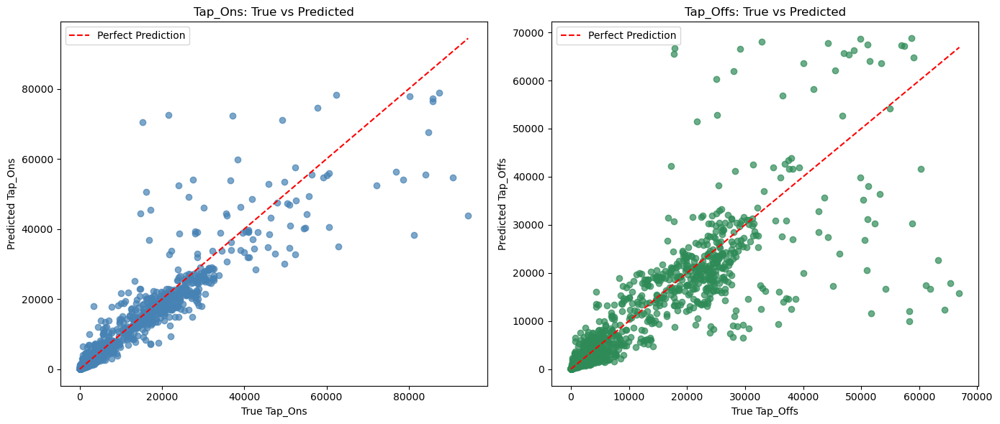

In [499]:
import matplotlib.pyplot as plt

# Assuming Y_test and Y_pred come from your XGBoost model
# Y_test: DataFrame with columns ["Tap_Ons", "Tap_Offs"]
# Y_pred: NumPy array from model.predict()

fig, ax = plt.subplots(1, 2, figsize=(14, 6))

# ---- Tap_Ons ----
ax[0].scatter(Y_test["Tap_Ons"], Y_pred[:, 0], alpha=0.7, color="steelblue")
ax[0].plot(
    [Y_test["Tap_Ons"].min(), Y_test["Tap_Ons"].max()],
    [Y_test["Tap_Ons"].min(), Y_test["Tap_Ons"].max()],
    "r--", label="Perfect Prediction"
)
ax[0].set_title("Tap_Ons: True vs Predicted")
ax[0].set_xlabel("True Tap_Ons")
ax[0].set_ylabel("Predicted Tap_Ons")
ax[0].legend()

# ---- Tap_Offs ----
ax[1].scatter(Y_test["Tap_Offs"], Y_pred[:, 1], alpha=0.7, color="seagreen")
ax[1].plot(
    [Y_test["Tap_Offs"].min(), Y_test["Tap_Offs"].max()],
    [Y_test["Tap_Offs"].min(), Y_test["Tap_Offs"].max()],
    "r--", label="Perfect Prediction"
)
ax[1].set_title("Tap_Offs: True vs Predicted")
ax[1].set_xlabel("True Tap_Offs")
ax[1].set_ylabel("Predicted Tap_Offs")
ax[1].legend()

plt.tight_layout()
plt.show()

# ElasticNet

In [500]:
from sklearn.linear_model import ElasticNet
from sklearn.multioutput import MultiOutputRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
import pandas as pd

# Step 1: Ensure date column is datetime
projected_df_encoded["trip_origin_date"] = pd.to_datetime(projected_df_encoded["trip_origin_date"])

# Step 2: Filter training (2022–2023) and test (2024)
train_df = projected_df_encoded[
    (projected_df_encoded["trip_origin_date"] >= "2022-12-01") &
    (projected_df_encoded["trip_origin_date"] < "2024-01-01")
].copy()

test_df = projected_df_encoded[
    (projected_df_encoded["trip_origin_date"] >= "2024-12-01") &
    (projected_df_encoded["trip_origin_date"] < "2025-01-01")
].copy()

# Step 3: Drop trip_origin_date post-filter
train_df = train_df.drop(columns=["trip_origin_date"])
test_df = test_df.drop(columns=["trip_origin_date"])

# Step 4: Split features and targets
X_train = train_df.drop(columns=["Tap_Ons", "Tap_Offs"])
Y_train = train_df[["Tap_Ons", "Tap_Offs"]]

X_test = test_df.drop(columns=["Tap_Ons", "Tap_Offs"])
Y_test = test_df[["Tap_Ons", "Tap_Offs"]]

# Step 5: Build pipeline with scaling (ElasticNet needs normalized features)
elastic_pipeline = MultiOutputRegressor(
    make_pipeline(
        StandardScaler(),
        ElasticNet(alpha=1.0, l1_ratio=0.5, max_iter=10000)
    )
)

# Step 6: Fit model
elastic_pipeline.fit(X_train, Y_train)

# Step 7: Predict
Y_pred = elastic_pipeline.predict(X_test)

# Step 8: Evaluate
mse_on = mean_squared_error(Y_test["Tap_Ons"], Y_pred[:, 0])
mse_off = mean_squared_error(Y_test["Tap_Offs"], Y_pred[:, 1])
r2_on = r2_score(Y_test["Tap_Ons"], Y_pred[:, 0])
r2_off = r2_score(Y_test["Tap_Offs"], Y_pred[:, 1])

print(f"📈 ElasticNet Tap_Ons → RMSE: {mse_on**0.5:.2f}, R²: {r2_on:.3f}")
print(f"📉 ElasticNet Tap_Offs → RMSE: {mse_off**0.5:.2f}, R²: {r2_off:.3f}")

📈 ElasticNet Tap_Ons → RMSE: 6813.22, R²: 0.472
📉 ElasticNet Tap_Offs → RMSE: 6133.01, R²: 0.520


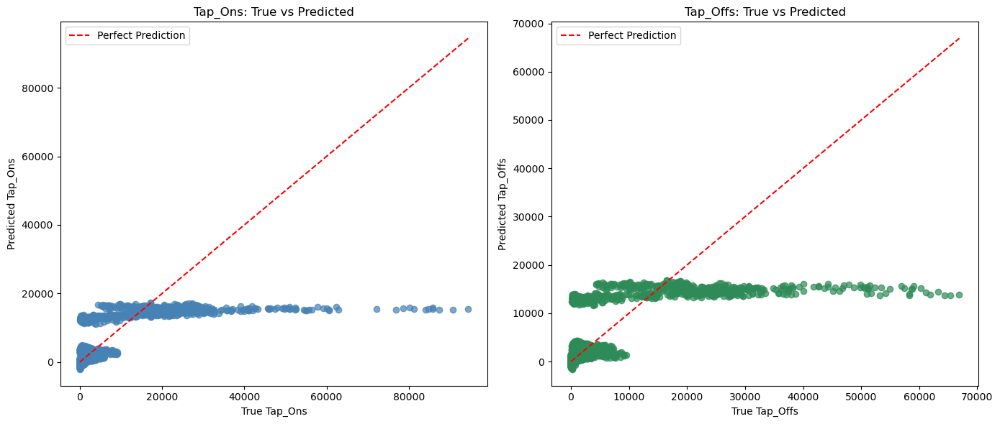

In [501]:
import matplotlib.pyplot as plt

# Assuming Y_test and Y_pred come from your XGBoost model
# Y_test: DataFrame with columns ["Tap_Ons", "Tap_Offs"]
# Y_pred: NumPy array from model.predict()

fig, ax = plt.subplots(1, 2, figsize=(14, 6))

# ---- Tap_Ons ----
ax[0].scatter(Y_test["Tap_Ons"], Y_pred[:, 0], alpha=0.7, color="steelblue")
ax[0].plot(
    [Y_test["Tap_Ons"].min(), Y_test["Tap_Ons"].max()],
    [Y_test["Tap_Ons"].min(), Y_test["Tap_Ons"].max()],
    "r--", label="Perfect Prediction"
)
ax[0].set_title("Tap_Ons: True vs Predicted")
ax[0].set_xlabel("True Tap_Ons")
ax[0].set_ylabel("Predicted Tap_Ons")
ax[0].legend()

# ---- Tap_Offs ----
ax[1].scatter(Y_test["Tap_Offs"], Y_pred[:, 1], alpha=0.7, color="seagreen")
ax[1].plot(
    [Y_test["Tap_Offs"].min(), Y_test["Tap_Offs"].max()],
    [Y_test["Tap_Offs"].min(), Y_test["Tap_Offs"].max()],
    "r--", label="Perfect Prediction"
)
ax[1].set_title("Tap_Offs: True vs Predicted")
ax[1].set_xlabel("True Tap_Offs")
ax[1].set_ylabel("Predicted Tap_Offs")
ax[1].legend()

plt.tight_layout()
plt.show()

# XGBOOST

In [502]:
import xgboost
from xgboost import XGBRegressor
from sklearn.multioutput import MultiOutputRegressor
from sklearn.metrics import mean_squared_error, r2_score
import pandas as pd

# Step 1: Ensure datetime format
projected_df_encoded["trip_origin_date"] = pd.to_datetime(projected_df_encoded["trip_origin_date"])

# Step 2: Filter training (2022–2023) and test (2024)
train_df = projected_df_encoded[
    (projected_df_encoded["trip_origin_date"] >= "2022-12-01") &
    (projected_df_encoded["trip_origin_date"] < "2024-01-01")
].copy()

test_df = projected_df_encoded[
    (projected_df_encoded["trip_origin_date"] >= "2024-12-01") &
    (projected_df_encoded["trip_origin_date"] < "2025-01-01")
].copy()

# Step 3: Drop date after filtering
train_df = train_df.drop(columns=["trip_origin_date"])
test_df = test_df.drop(columns=["trip_origin_date"])

# Step 4: Split features and targets
X_train = train_df.drop(columns=["Tap_Ons", "Tap_Offs"])
Y_train = train_df[["Tap_Ons", "Tap_Offs"]]

X_test = test_df.drop(columns=["Tap_Ons", "Tap_Offs"])
Y_test = test_df[["Tap_Ons", "Tap_Offs"]]

# Step 5: Train XGBoost
xgb_model = MultiOutputRegressor(XGBRegressor(
    n_estimators=100,
    learning_rate=0.1,
    max_depth=6,
    random_state=42,
    objective='reg:squarederror'
))

xgb_model.fit(X_train, Y_train)

# Step 6: Predict
Y_pred = xgb_model.predict(X_test)

# Step 7: Evaluate
mse_on = mean_squared_error(Y_test["Tap_Ons"], Y_pred[:, 0])
mse_off = mean_squared_error(Y_test["Tap_Offs"], Y_pred[:, 1])
r2_on = r2_score(Y_test["Tap_Ons"], Y_pred[:, 0])
r2_off = r2_score(Y_test["Tap_Offs"], Y_pred[:, 1])

print(f"🌲 XGBoost Tap_Ons → RMSE: {mse_on**0.5:.2f}, R²: {r2_on:.3f}")
print(f"🌲 XGBoost Tap_Offs → RMSE: {mse_off**0.5:.2f}, R²: {r2_off:.3f}")

🌲 XGBoost Tap_Ons → RMSE: 2830.07, R²: 0.909
🌲 XGBoost Tap_Offs → RMSE: 3491.29, R²: 0.844


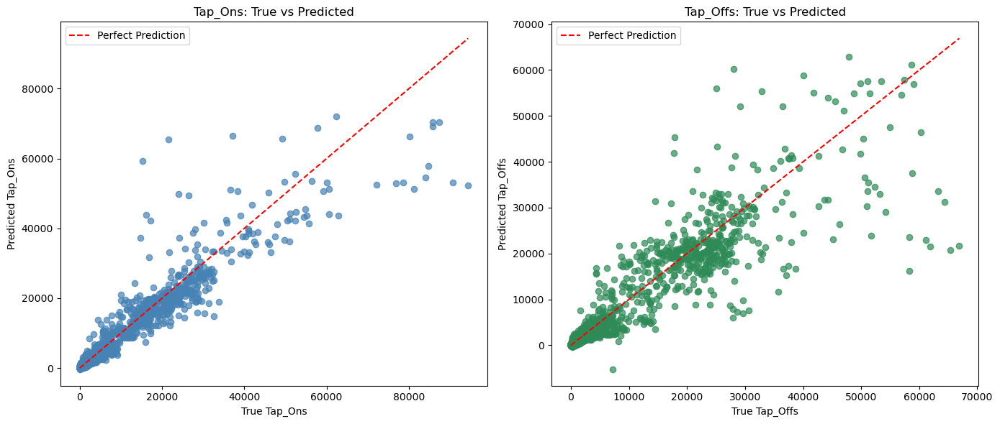

In [503]:
import matplotlib.pyplot as plt

# Assuming Y_test and Y_pred come from your XGBoost model
# Y_test: DataFrame with columns ["Tap_Ons", "Tap_Offs"]
# Y_pred: NumPy array from model.predict()

fig, ax = plt.subplots(1, 2, figsize=(14, 6))

# ---- Tap_Ons ----
ax[0].scatter(Y_test["Tap_Ons"], Y_pred[:, 0], alpha=0.7, color="steelblue")
ax[0].plot(
    [Y_test["Tap_Ons"].min(), Y_test["Tap_Ons"].max()],
    [Y_test["Tap_Ons"].min(), Y_test["Tap_Ons"].max()],
    "r--", label="Perfect Prediction"
)
ax[0].set_title("Tap_Ons: True vs Predicted")
ax[0].set_xlabel("True Tap_Ons")
ax[0].set_ylabel("Predicted Tap_Ons")
ax[0].legend()

# ---- Tap_Offs ----
ax[1].scatter(Y_test["Tap_Offs"], Y_pred[:, 1], alpha=0.7, color="seagreen")
ax[1].plot(
    [Y_test["Tap_Offs"].min(), Y_test["Tap_Offs"].max()],
    [Y_test["Tap_Offs"].min(), Y_test["Tap_Offs"].max()],
    "r--", label="Perfect Prediction"
)
ax[1].set_title("Tap_Offs: True vs Predicted")
ax[1].set_xlabel("True Tap_Offs")
ax[1].set_ylabel("Predicted Tap_Offs")
ax[1].legend()

plt.tight_layout()
plt.show()

# Visualizations

In [482]:
christmas_range_df = projected_df_encoded[
    (projected_df_encoded["trip_origin_date"] >= "2024-12-01") &
    (projected_df_encoded["trip_origin_date"] <= "2025-01-01")
]

In [483]:
christmas_range_df

,trip_origin_date,Tap_Ons,Tap_Offs,tap_hour,total_people,total_size,total_hospitality_size,site_poi_count,tourist_poi_count,shop_poi_count,...,day_label_12/4,day_label_12/5,day_label_12/6,day_label_12/7,day_label_12/8,day_label_12/9,ti_region_North Sydney,ti_region_Parramatta,ti_region_Strathfield,ti_region_Sydney CBD
1487,2024-12-01,300.0,400.0,0,77156.0,85250.0,8550.0,164.0,0.0,6.0,...,0,0,0,0,0,0,0,0,0,0
1488,2024-12-01,100.0,200.0,1,77156.0,85250.0,8550.0,164.0,0.0,6.0,...,0,0,0,0,0,0,0,0,0,0
1489,2024-12-01,0.0,0.0,2,77156.0,85250.0,8550.0,164.0,0.0,6.0,...,0,0,0,0,0,0,0,0,0,0
1490,2024-12-01,0.0,0.0,3,77156.0,85250.0,8550.0,164.0,0.0,6.0,...,0,0,0,0,0,0,0,0,0,0
1491,2024-12-01,0.0,0.0,4,77156.0,85250.0,8550.0,164.0,0.0,6.0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11153,2024-12-31,13400.0,20900.0,19,28545.0,319000.0,23600.0,81.0,9.0,1.0,...,0,0,0,0,0,0,0,0,0,1
11154,2024-12-31,10000.0,17200.0,20,28545.0,319000.0,23600.0,81.0,9.0,1.0,...,0,0,0,0,0,0,0,0,0,1
11155,2024-12-31,24600.0,13800.0,21,28545.0,319000.0,23600.0,81.0,9.0,1.0,...,0,0,0,0,0,0,0,0,0,1
11156,2024-12-31,18600.0,18900.0,22,28545.0,319000.0,23600.0,81.0,9.0,1.0,...,0,0,0,0,0,0,0,0,0,1


In [485]:
Y_pred = xgb_model.predict(christmas_range_df.drop(columns=["trip_origin_date","Tap_Ons", "Tap_Offs"]))

# Add predictions back to test_df
christmas_range_df["tap_on_predicted"] = Y_pred[:, 0]
christmas_range_df["tap_off_predicted"] = Y_pred[:, 1]

In [490]:
christmas_range_df

,trip_origin_date,Tap_Ons,Tap_Offs,tap_hour,total_people,total_size,total_hospitality_size,site_poi_count,tourist_poi_count,shop_poi_count,...,day_label_12/6,day_label_12/7,day_label_12/8,day_label_12/9,ti_region_North Sydney,ti_region_Parramatta,ti_region_Strathfield,ti_region_Sydney CBD,tap_on_predicted,tap_off_predicted
1487,2024-12-01,300.0,400.0,0,77156.0,85250.0,8550.0,164.0,0.0,6.0,...,0,0,0,0,0,0,0,0,112.663177,136.059326
1488,2024-12-01,100.0,200.0,1,77156.0,85250.0,8550.0,164.0,0.0,6.0,...,0,0,0,0,0,0,0,0,72.025177,39.687412
1489,2024-12-01,0.0,0.0,2,77156.0,85250.0,8550.0,164.0,0.0,6.0,...,0,0,0,0,0,0,0,0,49.109619,-0.499077
1490,2024-12-01,0.0,0.0,3,77156.0,85250.0,8550.0,164.0,0.0,6.0,...,0,0,0,0,0,0,0,0,49.109619,-0.499077
1491,2024-12-01,0.0,0.0,4,77156.0,85250.0,8550.0,164.0,0.0,6.0,...,0,0,0,0,0,0,0,0,50.444283,-0.499077
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11153,2024-12-31,13400.0,20900.0,19,28545.0,319000.0,23600.0,81.0,9.0,1.0,...,0,0,0,0,0,0,0,1,24243.433594,33645.988281
11154,2024-12-31,10000.0,17200.0,20,28545.0,319000.0,23600.0,81.0,9.0,1.0,...,0,0,0,0,0,0,0,1,21106.851562,22243.947266
11155,2024-12-31,24600.0,13800.0,21,28545.0,319000.0,23600.0,81.0,9.0,1.0,...,0,0,0,0,0,0,0,1,22095.943359,21237.083984
11156,2024-12-31,18600.0,18900.0,22,28545.0,319000.0,23600.0,81.0,9.0,1.0,...,0,0,0,0,0,0,0,1,19696.921875,20770.462891


In [491]:
christmas_range_df["timestamp"] = pd.to_datetime(christmas_range_df["trip_origin_date"]) + pd.to_timedelta(christmas_range_df["tap_hour"], unit="h")

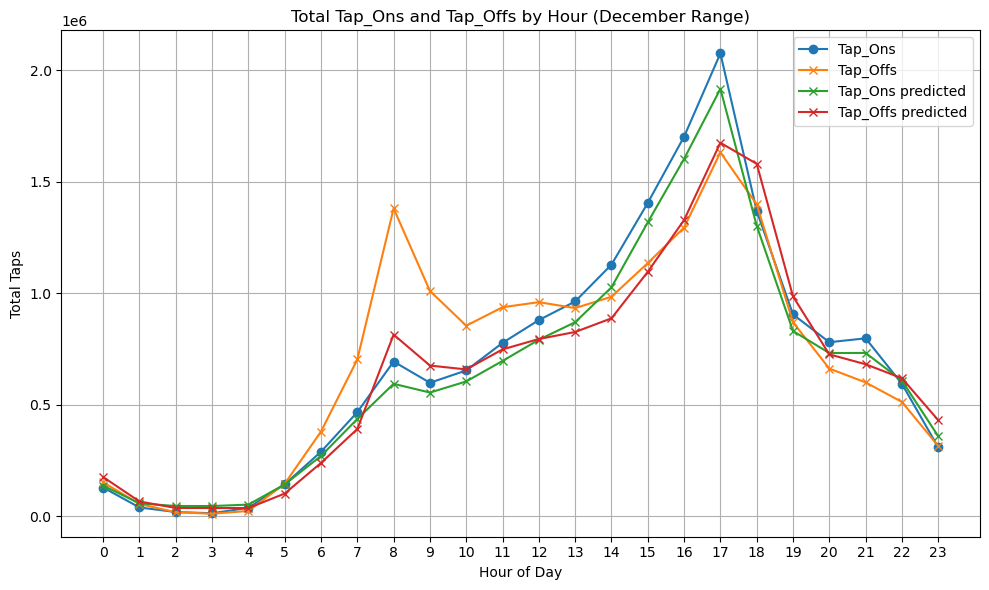

In [512]:
import matplotlib.pyplot as plt

# Group by hour and sum
hourly_summary = christmas_range_df.groupby("tap_hour")[["Tap_Ons", "Tap_Offs", "tap_on_predicted", "tap_off_predicted"]].sum().reset_index()

# Plot
plt.figure(figsize=(10, 6))
plt.plot(hourly_summary["tap_hour"], hourly_summary["Tap_Ons"], marker='o', label="Tap_Ons")
plt.plot(hourly_summary["tap_hour"], hourly_summary["Tap_Offs"], marker='x', label="Tap_Offs")
plt.plot(hourly_summary["tap_hour"], hourly_summary["tap_on_predicted"], marker='x', label="Tap_Ons predicted")
plt.plot(hourly_summary["tap_hour"], hourly_summary["tap_off_predicted"], marker='x', label="Tap_Offs predicted")
plt.xlabel("Hour of Day")
plt.ylabel("Total Taps")
plt.title("Total Tap_Ons and Tap_Offs by Hour (December Range)")
plt.legend()
plt.grid(True)
plt.xticks(range(0, 24))
plt.tight_layout()
plt.show()

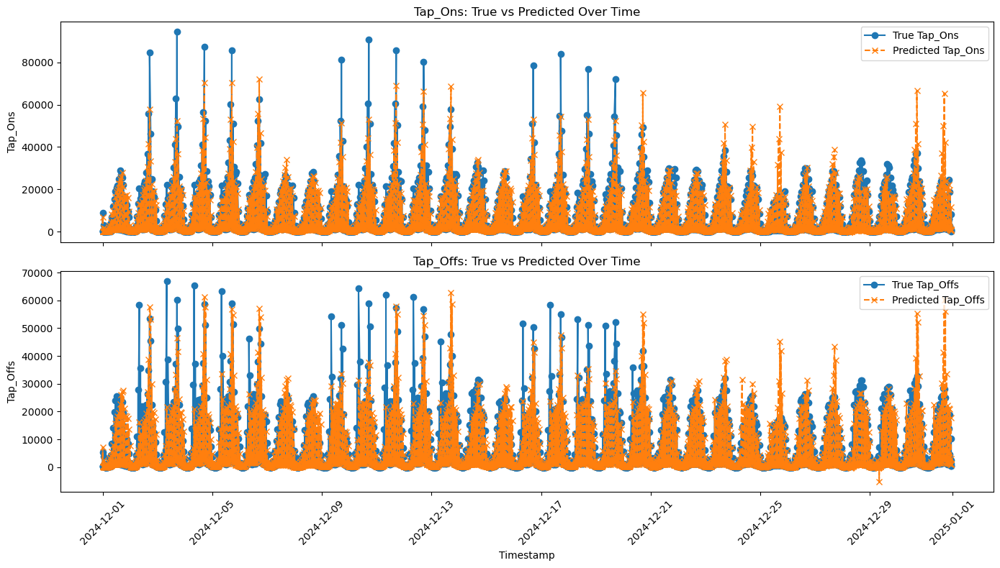

In [513]:
import matplotlib.pyplot as plt

# Sort by timestamp just in case
christmas_range_df = christmas_range_df.sort_values("timestamp")

# Plot
fig, ax = plt.subplots(2, 1, figsize=(14, 8), sharex=True)

# Tap_Ons
ax[0].plot(christmas_range_df["timestamp"], christmas_range_df["Tap_Ons"], label="True Tap_Ons", marker='o', linestyle='-')
ax[0].plot(christmas_range_df["timestamp"], christmas_range_df["tap_on_predicted"], label="Predicted Tap_Ons", marker='x', linestyle='--')
ax[0].set_ylabel("Tap_Ons")
ax[0].set_title("Tap_Ons: True vs Predicted Over Time")
ax[0].legend()

# Tap_Offs
ax[1].plot(christmas_range_df["timestamp"], christmas_range_df["Tap_Offs"], label="True Tap_Offs", marker='o', linestyle='-')
ax[1].plot(christmas_range_df["timestamp"], christmas_range_df["tap_off_predicted"], label="Predicted Tap_Offs", marker='x', linestyle='--')
ax[1].set_ylabel("Tap_Offs")
ax[1].set_title("Tap_Offs: True vs Predicted Over Time")
ax[1].legend()

plt.xlabel("Timestamp")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

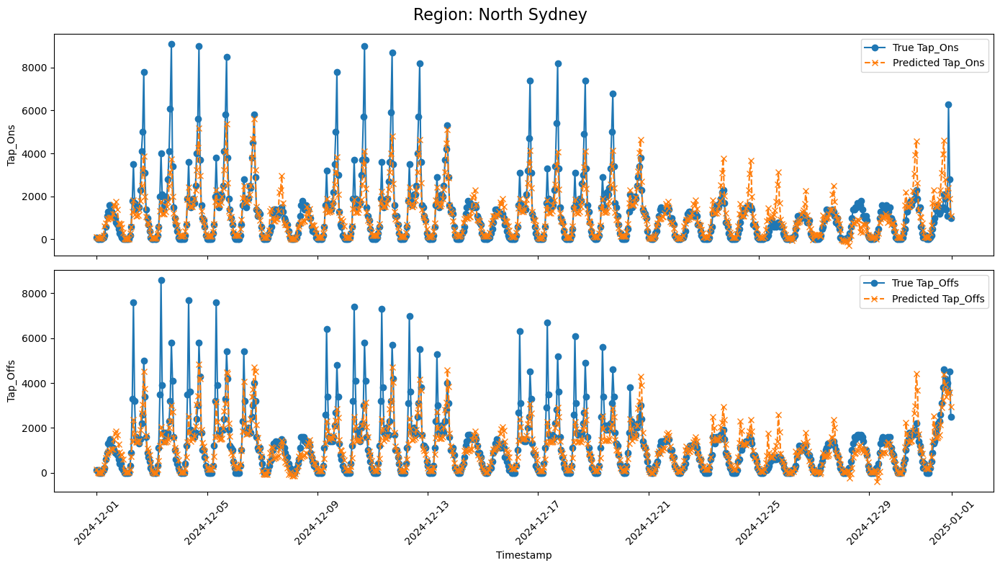

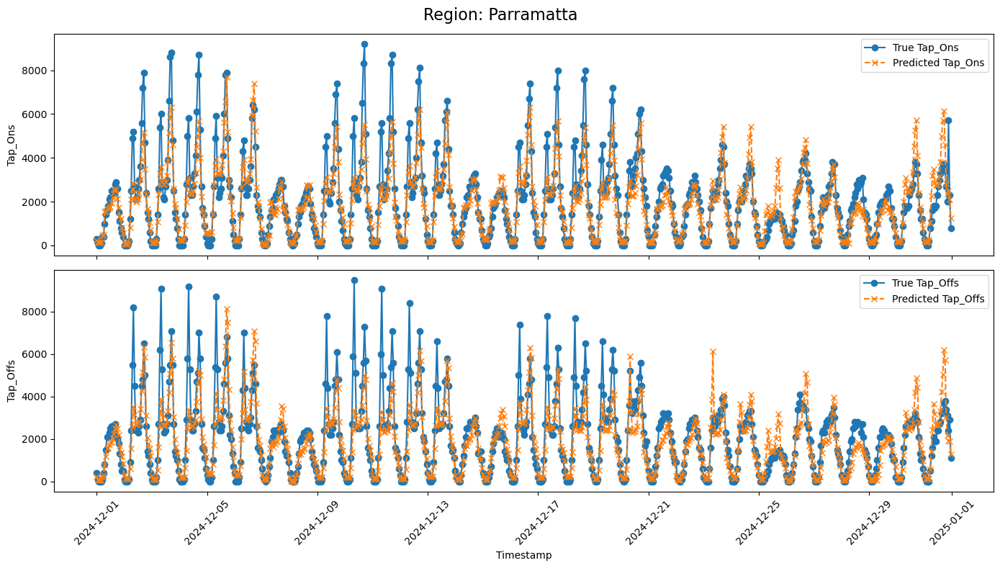

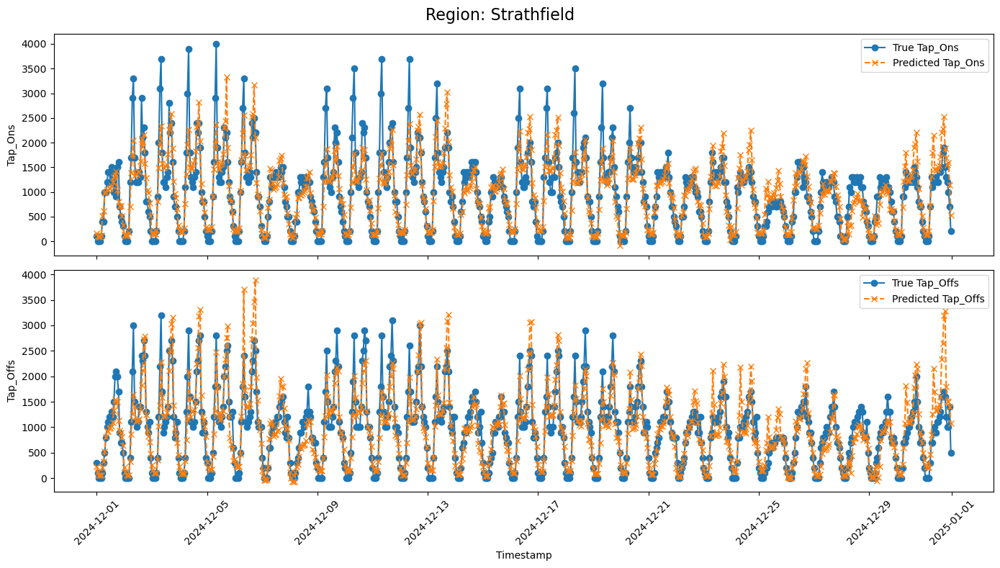

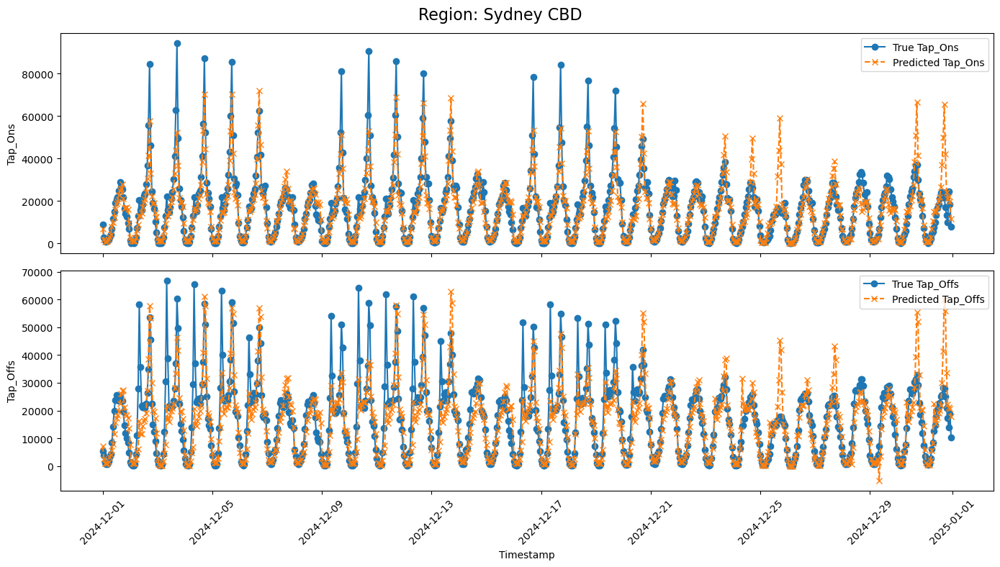

In [511]:
import matplotlib.pyplot as plt

# Step 1: Extract region names from dummy columns
region_columns = [col for col in christmas_range_df.columns if col.startswith("ti_region_")]

# Step 2: For each region, extract the rows and plot
for region_col in region_columns:
    region_name = region_col.replace("ti_region_", "")
    
    # Filter rows where this region dummy is 1
    region_df = christmas_range_df[christmas_range_df[region_col] == 1].sort_values("timestamp")
    
    if region_df.empty:
        continue  # skip empty regions
    
    # Plot
    fig, ax = plt.subplots(2, 1, figsize=(14, 8), sharex=True)
    fig.suptitle(f"Region: {region_name}", fontsize=16)

    # Tap_Ons
    ax[0].plot(region_df["timestamp"], region_df["Tap_Ons"], label="True Tap_Ons", marker='o', linestyle='-')
    ax[0].plot(region_df["timestamp"], region_df["tap_on_predicted"], label="Predicted Tap_Ons", marker='x', linestyle='--')
    ax[0].set_ylabel("Tap_Ons")
    ax[0].legend()

    # Tap_Offs
    ax[1].plot(region_df["timestamp"], region_df["Tap_Offs"], label="True Tap_Offs", marker='o', linestyle='-')
    ax[1].plot(region_df["timestamp"], region_df["tap_off_predicted"], label="Predicted Tap_Offs", marker='x', linestyle='--')
    ax[1].set_ylabel("Tap_Offs")
    ax[1].legend()

    plt.xlabel("Timestamp")
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

In [ ]:
# Step 1: Identify the dummy region columns
region_cols = [col for col in christmas_range_df.columns if col.startswith("ti_region_")]

# Step 2: Reconstruct the region name from the dummy columns
def get_region_from_dummies(row):
    for col in region_cols:
        if row[col] == 1:
            return col.replace("ti_region_", "")
    return None  # fallback

christmas_range_df["region"] = christmas_range_df.apply(get_region_from_dummies, axis=1)

# Step 3: Merge with region_aggregated on 'region'
christmas_with_geometry = christmas_range_df.merge(
    region_aggregated[["region", "geometry"]],
    on="region",
    how="left"
)

In [ ]:
christmas_with_geometry

In [ ]:
christmas_with_geometry["net_flow"] = christmas_with_geometry["Tap_Offs"] - christmas_with_geometry["Tap_Ons"]
christmas_with_geometry["predicted_net_flow"] = christmas_with_geometry["tap_off_predicted"] - christmas_with_geometry["tap_on_predicted"]

In [ ]:
christmas_with_geometry

In [ ]:
# Dictionary to store the DataFrames keyed by timestamp
timestamp_groups = {
    timestamp: group.reset_index(drop=True)
    for timestamp, group in christmas_with_geometry.groupby("timestamp")
}


In [ ]:
timestamp_groups

In [ ]:
global_min = min(df["net_flow"].min() for df in timestamp_groups.values())
global_max = max(df["net_flow"].max() for df in timestamp_groups.values())

In [ ]:
import matplotlib.pyplot as plt
import geopandas as gpd
flag = True
for timestamp, df in timestamp_groups.items():
    if flag:
        gdf = gpd.GeoDataFrame(df, geometry="geometry", crs="EPSG:4326")
        fig, ax = plt.subplots(1, 1, figsize=(8, 8))
        gdf.plot(
            column="net_flow",
            cmap="coolwarm",
            linewidth=0.5,
            edgecolor="black",
            legend=True,
            ax=ax,
            vmin=global_min,
            vmax=global_max
        )
        ax.set_title(f"Net Flow Heatmap - {timestamp}")
        ax.axis("off")
        plt.tight_layout()
        plt.show()
        flag = False

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import geopandas as gpd
import numpy as np
import matplotlib.cm as cm
import matplotlib.colors as colors

# Prepare global color scale
global_min = -3000
global_max = 2000
norm = colors.Normalize(vmin=global_min, vmax=global_max)
cmap = cm.get_cmap("coolwarm")

# Prepare figure and axis
fig, ax = plt.subplots(figsize=(8, 8))

# Create mappable for shared colorbar
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm._A = []  # required hack for older matplotlib versions

# Sorted timestamps
frames = [(ts, gpd.GeoDataFrame(df, geometry="geometry", crs="EPSG:4326")) for ts, df in sorted(timestamp_groups.items())]

def init():
    ax.set_axis_off()
    return []

def update(i):
    ax.clear()
    ts, gdf = frames[i]
    gdf.plot(
        column="net_flow",
        cmap=cmap,
        norm=norm,
        linewidth=0.5,
        edgecolor="black",
        ax=ax
    )
    ax.set_title(f"Net Flow Heatmap\n{ts}")
    ax.set_axis_off()
    return []

# Draw colorbar once
cbar = fig.colorbar(sm, ax=ax, orientation="vertical", fraction=0.03, pad=0.01)
cbar.set_label("Net Flow")

# Create animation
ani = animation.FuncAnimation(fig, update, frames=len(frames), init_func=init, repeat=False)

# Save or display
ani.save("net_flow_timelapse.mp4", writer="ffmpeg", fps=16)
plt.show()

In [ ]:
import matplotlib.pyplot as plt
import geopandas as gpd

flag = True

for timestamp, df in timestamp_groups.items():
    if flag:
        gdf = gpd.GeoDataFrame(df, geometry="geometry", crs="EPSG:4326")
        fig, ax = plt.subplots(1, 1, figsize=(8, 8))
        gdf.plot(
            column="predicted_net_flow",
            cmap="coolwarm",
            linewidth=0.5,
            edgecolor="black",
            legend=True,
            ax=ax,
            vmin=global_min,
            vmax=global_max
        )
        ax.set_title(f"Net Flow Heatmap - {timestamp}")
        ax.axis("off")
        plt.tight_layout()
        plt.show()
        flag = False

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import geopandas as gpd
import numpy as np
import matplotlib.cm as cm
import matplotlib.colors as colors

# Prepare global color scale
global_min = -3000
global_max = 2000
norm = colors.Normalize(vmin=global_min, vmax=global_max)
cmap = cm.get_cmap("coolwarm")

# Prepare figure and axis
fig, ax = plt.subplots(figsize=(8, 8))

# Create mappable for shared colorbar
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm._A = []  # required hack for older matplotlib versions

# Sorted timestamps
frames = [(ts, gpd.GeoDataFrame(df, geometry="geometry", crs="EPSG:4326")) for ts, df in sorted(timestamp_groups.items())]

def init():
    ax.set_axis_off()
    return []

def update(i):
    ax.clear()
    ts, gdf = frames[i]
    gdf.plot(
        column="net_flow",
        cmap=cmap,
        norm=norm,
        linewidth=0.5,
        edgecolor="black",
        ax=ax
    )
    ax.set_title(f"Predicted Net Flow Heatmap\n{ts}")
    ax.set_axis_off()
    return []

# Draw colorbar once
cbar = fig.colorbar(sm, ax=ax, orientation="vertical", fraction=0.03, pad=0.01)
cbar.set_label("Predicted Net Flow")

# Create animation
ani = animation.FuncAnimation(fig, update, frames=len(frames), init_func=init, repeat=False)

# Save or display
ani.save("predicted_net_flow_timelapse.mp4", writer="ffmpeg", fps=16)
plt.show()

# IV. Limitations and assumptions

# Limitations

Our understanding of time series models is limited.

Besides, some limitations of the datasets are:
- **Opal Patronage:**
  
  - The 3/6/2021 and 4/6/2021 files are empty
  
  - Small number of regions (locations): There are only 6 regions in Greater Sydney and 2 regions outside (in Newcastle and Wollongong). 
  
  - Number of tap ons and tap offs are allocated to a region, so it is hard to determine the exact route passengers took and make observations or recommendations for a specific station or stop (e.g., to reduce or increase service).

- **Weather data:**
  
  - Not all weather stations measure maximum & minimum daily temperature, so we had to take data from farther away: For Chatswood, we used data observed at Observatory Hill (9.33km away). For Macquarie Park, we used data observed at Sydney Olympic Park (8.33km away).
  
Our work isn’t fully done due to time limitations. If anyone wants to continue our work, a direction they can work on is integrating the Opal Assignment Model, which includes historic occupancy for individual public transport services from 2019. By utilising it, they will be able to determine more accurately the public transport usage of each individual service and the number of people departing and arriving at each station or stop. As a result, they will be able to give recommendations specific to a station or stop. We were unable to predict the traffic of the regions connecting our 6 researched regions. It would shed a lot of insight into how the flow of traffic works between these regions. This is caused by limitations of our data as well as time and expertise constraint in exercising geospatial techniques to better predict the traffic.

# Assumptions

The datasets include correct measurements of geospatial data, hourly Opal patronage and weather data. We assume unchanging weather conditions within a day, that the number of people moving from our researched regions to other regions unmentioned is negligible and that the dispersion of population within each postal code region is homogeneous.